# Library

| **모델링 종류** | **알고리즘 분야** | **이름** | **개발연도** |
|:---:|:---:|:---:|:---:|
| **Machine Learning** | **Bagging** | RandomForest | 2001 |
|  | **Boosting** | XGBoost | 2014 |
|  |  | LightGBM | 2016 |
|  |  | CatBoost | 2017 |
| **Deep Learning** | **MLP** | MLP | 2010 |
|  |  | NBEATS | 2019 |
|  |  | NHITS | 2021 |
|  |  | NBEATSx | 2021 |
|  |  | TiDE | 2023 |
|  |  | DeepNPTS | 2023 |
|  | **RNN** | RNN | 2014 |
|  |  | LSTM | 2014 |
|  |  | GRU | 2014 |
|  |  | DilatedRNN | 2017 |
|  |  | TCN | 2018 |
|  |  | DeepAR | 2020 |
|  | **Transformer** | Vanilla Transformer | 2021 |
|  |  | Informer | 2021 |
|  |  | TFT | 2021 |
|  |  | Autoformer | 2021 |
|  |  | PatchTST | 2022 |


In [1]:
# Ignore the warnings
import warnings
# warnings.filterwarnings('always')
warnings.filterwarnings('ignore')

# System related and data input controls
import os

# Python path
import sys
base_folder = 'DataScience'
location_base = os.path.join(os.getcwd().split(base_folder)[0], base_folder)
location_module = [os.path.join(location_base, 'Module')] 
for each in location_module:
    if each not in sys.path:
        sys.path.append(each)

# Auto reload of library
%reload_ext autoreload
%autoreload 2

from module_KTX_KK import * 
from preprocessing_KK import *
from algorithm_machinelearning_KK import *
from algorithm_deeplearning_KK import *
from evaluation_KK import *

JAVA is in the system path?:  False
JAVA is in the system path?:  Adding...
Operation Machine:  Intel64 Family 6 Model 186 Stepping 2, GenuineIntel
Operation Platform:  64bit
OS Type:  Windows
OS Version:  11
Python Version:  3.12.3 | packaged by conda-forge | (main, Apr 15 2024, 18:20:11) [MSC v.1938 64 bit (AMD64)]


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package tagsets_json to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package tagsets_json is already up-to-date!
[Kss]: From C:\Users\KK\anaconda3\Lib\site-packages\tf_keras\src\losses.py:2976: The name tf.losses.sparse_softmax_cross_entropy is deprecated. Please use tf.compat.v1.losses.sparse_softmax_cross_entropy instead.



# Hyperparameters

In [2]:
# 분석싸이클
## 데이터로딩
file_name = 'df_KTX_monthsum_KCI_KK.csv'
df = pd.read_csv(os.path.join('.', 'Data', file_name)).iloc[:,1:]
## 필터링
# df = df.iloc[:,:-5]
## 대상
lines = ['경부선', '경전선', '동해선', '전라선', '호남선']
dows = ['전체']
## 변수구분
Y_colname = '승차인원수'
X_delete = ['전체주중주말', '주운행선']
## 기간구분
DATE_SPLITS = ['2023-03-31', '2024-03-31']
## 모델링
LEVELS = [90, 75]
ALGOS_ML = ['RandomForest', 'XGBoost', 'LightGBM', 'CatBoost']
# ALGOS_ML = []
CONFIG_CUSTOM_ML = {}
N_WINDOWS = 2
RANDOM_STATE = 123
VERBOSITY = 0
# ALGOS_DL = [MLP, NHITS, NBEATSx, TiDE, RNN, LSTM, GRU, DilatedRNN, TCN]
ALGOS_DL = [MLP, RNN, LSTM, GRU]
CONFIG_CUSTOM_DL = {'loss':MQLoss(level=LEVELS), 'max_steps':1000}
## 검증방향
RANKING = True
RANKING_METRIC = ['MSPE', 'MAPE', 'MedAPE']

# 최적화
## 결과위치
folder_result = '20250206_KCI'
## 방향
n_top_algo = 3
criteria = 'Top_Average' # 'MSPE', 'MAPE', 'MedAPE', 'Top_Average'
## 비교기간설정
year_prediction = ['2025']
year_comparison = ['2019', '2024']

# 최종예측
## 저장
save_name_final = 'KTXForecasting_KCI_KK.xlsx'

# Learning

## 시간정보+도메인지식+외부환경+과거수요

전체 경부선


[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: You are using a CUDA device ('NVIDIA GeForce RTX 4070 Laptop GPU') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name         | Type          | Params | Mode 
-------------------------------------------------------
0 | loss         | MQLoss        | 5      | train
1 | padder_train | ConstantPad1d | 0      | train
2 | scaler       | TemporalNorm  | 0      | train
3 | mlp          | ModuleList    | 4.6 M  | train
4 | out          | Linear        |

Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | RNN           | 126 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
373 K     Trainable params
5         Non-trainable params
373 K     Total params
1.494     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | LSTM          | 505 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
752 K     Trainable params
5         Non-trainable params
752 K     Total params
3.010     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | GRU           | 379 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
626 K     Trainable params
5         Non-trainable params
626 K     Total params
2.505     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

,MSE,RMSE,MSPE,MAE,MAPE,MedAE,MedAPE
LightGBM,"33,602,374,987.1590","183,309.5060",0.0030,"148,672.2037",0.0439,"99,093.7535",0.0279
RandomForest,"40,193,251,740.0371","200,482.5472",0.0035,"174,520.7217",0.0513,"181,346.6000",0.0549
CatBoost,"40,502,312,725.6486","201,251.8639",0.0035,"180,439.4279",0.0527,"189,825.0806",0.0541
MLP,"95,620,127,827.1979","309,225.0440",0.0080,"232,041.2083",0.0674,"164,389.0000",0.0498
XGBoost,"55,264,179,195.0781","235,083.3452",0.0047,"220,373.4375",0.0644,"240,597.8750",0.0703
RNN,"77,189,679,835.1979","277,830.3076",0.0066,"273,583.2917",0.0802,"273,917.2500",0.0793
GRU,"86,013,318,476.4167","293,280.2729",0.0073,"290,139.2500",0.0848,"292,087.2500",0.0843
LSTM,"90,044,669,475.9740","300,074.4399",0.0077,"290,527.0208",0.0849,"295,413.8750",0.0872


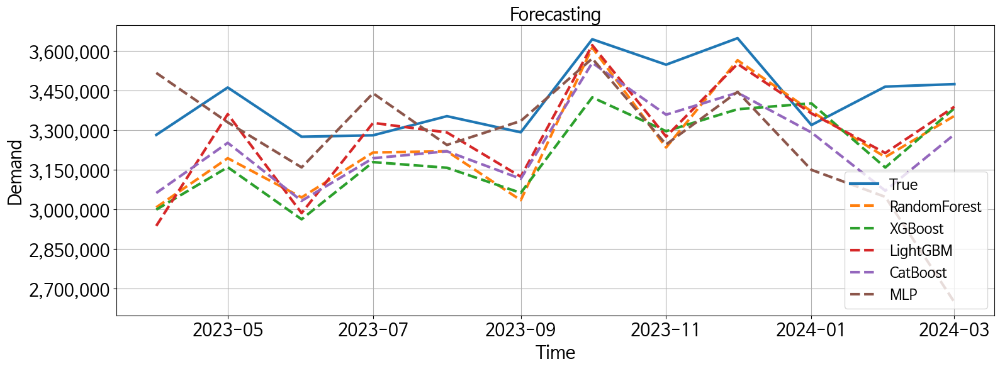

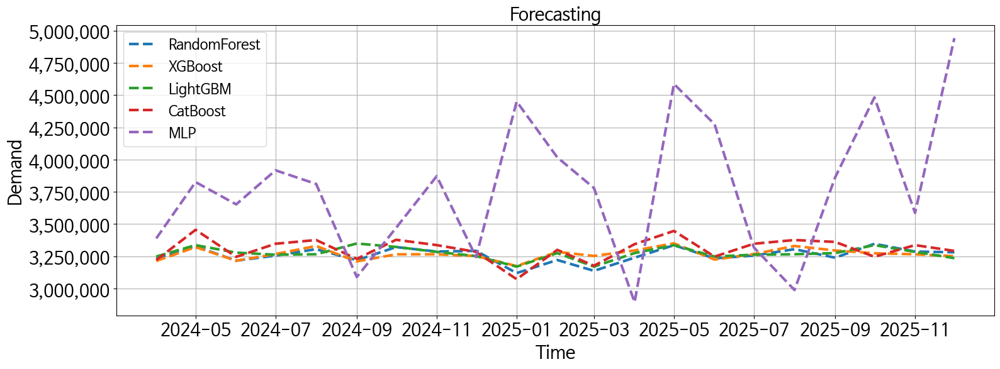

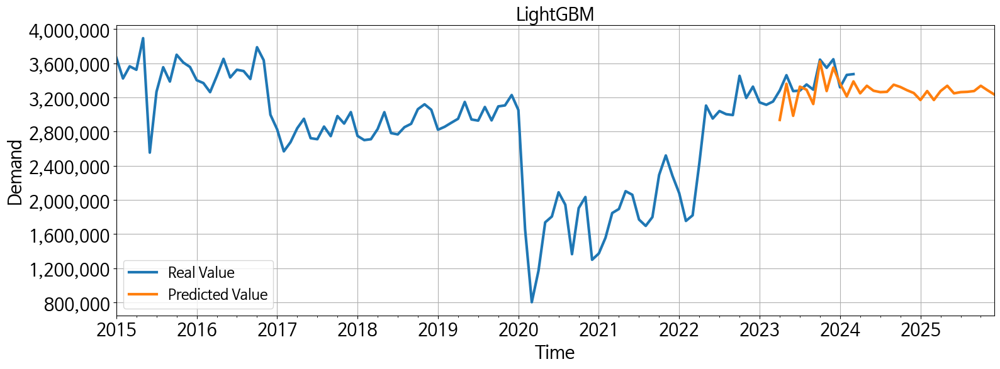

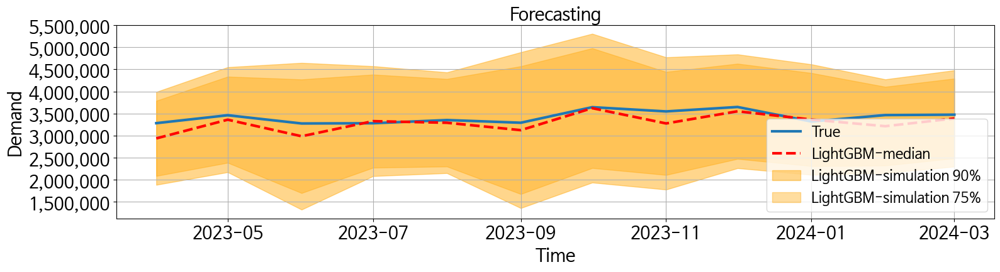

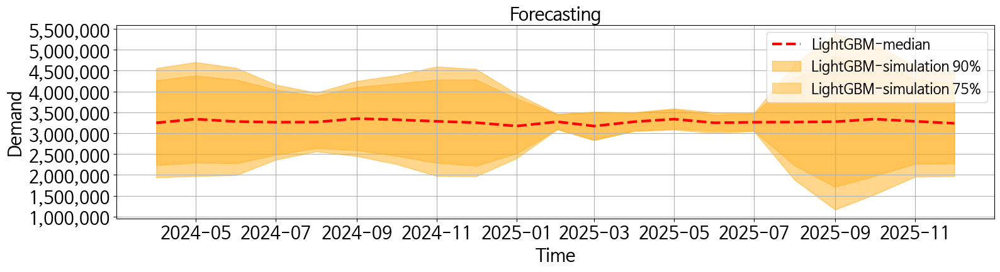

전체 경전선


[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name         | Type          | Params | Mode 
-------------------------------------------------------
0 | loss         | MQLoss        | 5      | train
1 | padder_train | ConstantPad1d | 0      | train
2 | scaler       | TemporalNorm  | 0      | train
3 | mlp          | ModuleList    | 4.6 M  | train
4 | out          | Linear        | 169 K  | train
-------------------------------------------------------
4.7 M     Trainable params
5         Non-trainable params
4.7 M     Total params
18.936    Total estimated model params size (MB)
7         Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | RNN           | 126 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
373 K     Trainable params
5         Non-trainable params
373 K     Total params
1.494     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | LSTM          | 505 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
752 K     Trainable params
5         Non-trainable params
752 K     Total params
3.010     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | GRU           | 379 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
626 K     Trainable params
5         Non-trainable params
626 K     Total params
2.505     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

,MSE,RMSE,MSPE,MAE,MAPE,MedAE,MedAPE
LightGBM,"4,514,243,479.7725","67,188.1201",0.0094,"64,373.5657",0.0935,"62,539.0988",0.0922
LSTM,"5,855,605,101.1735","76,521.9256",0.0125,"72,269.6823",0.1059,"76,625.2812",0.1182
RNN,"6,740,433,376.4977","82,100.1424",0.0144,"81,572.7240",0.1194,"82,413.5938",0.1216
XGBoost,"7,517,922,844.7555","86,705.9562",0.0159,"85,452.1094",0.1248,"88,642.1250",0.1314
GRU,"8,346,543,308.0824","91,359.4183",0.0180,"89,076.6615",0.1307,"93,836.1562",0.1343
CatBoost,"9,267,451,534.1109","96,267.6038",0.0196,"95,083.6631",0.1388,"92,038.7038",0.1351
RandomForest,"8,969,586,333.5037","94,707.9001",0.0189,"92,786.7675",0.1353,"95,037.4950",0.1401
MLP,"49,496,737,922.1797","222,478.6235",0.1084,"185,262.3021",0.2738,"194,126.4375",0.2923


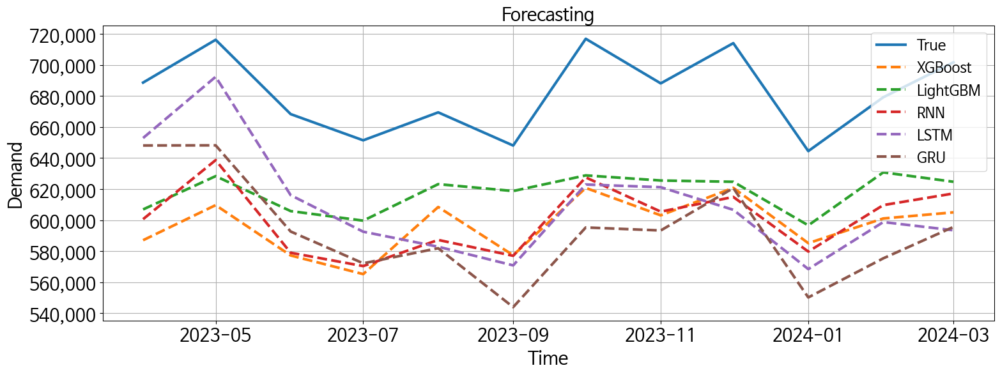

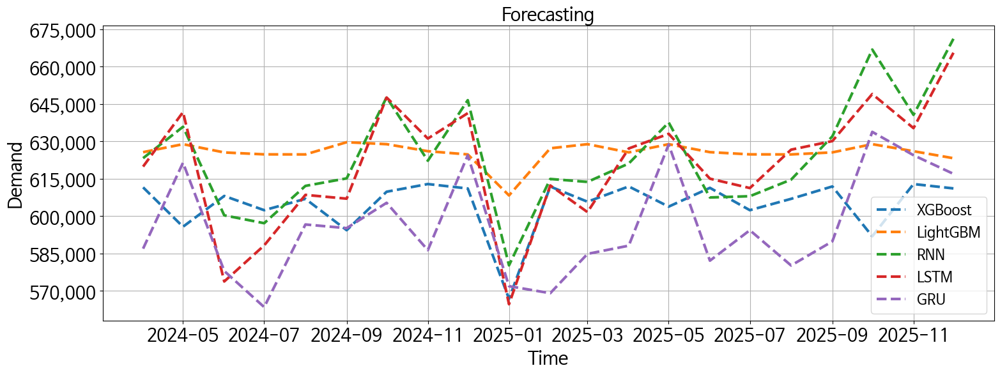

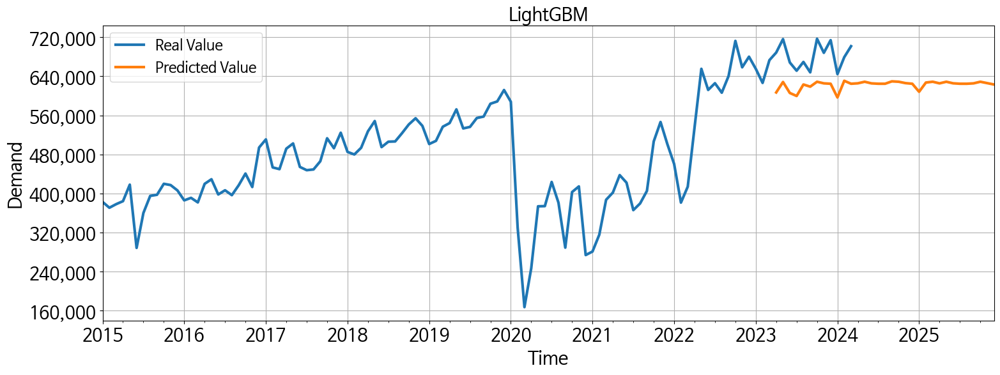

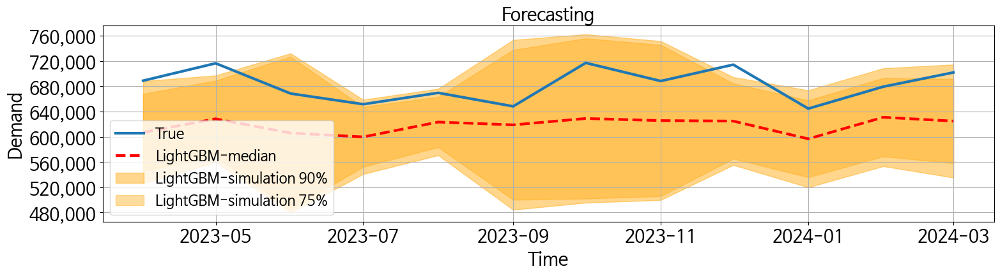

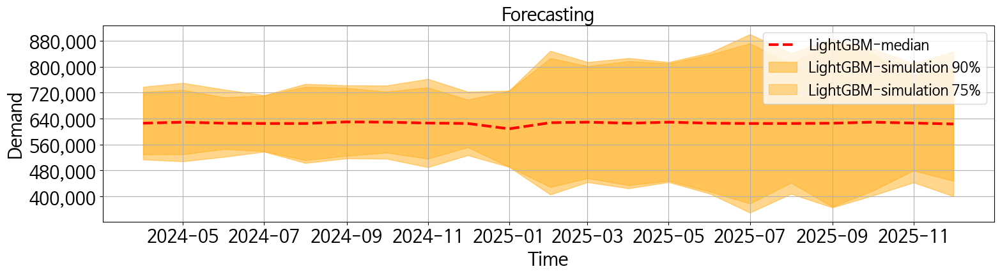

전체 동해선


[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name         | Type          | Params | Mode 
-------------------------------------------------------
0 | loss         | MQLoss        | 5      | train
1 | padder_train | ConstantPad1d | 0      | train
2 | scaler       | TemporalNorm  | 0      | train
3 | mlp          | ModuleList    | 4.6 M  | train
4 | out          | Linear        | 169 K  | train
-------------------------------------------------------
4.7 M     Trainable params
5         Non-trainable params
4.7 M     Total params
18.936    Total estimated model params size (MB)
7         Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | RNN           | 126 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
373 K     Trainable params
5         Non-trainable params
373 K     Total params
1.494     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | LSTM          | 505 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
752 K     Trainable params
5         Non-trainable params
752 K     Total params
3.010     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | GRU           | 379 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
626 K     Trainable params
5         Non-trainable params
626 K     Total params
2.505     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

,MSE,RMSE,MSPE,MAE,MAPE,MedAE,MedAPE
XGBoost,"3,179,446,305.3293","56,386.5791",0.0091,"53,733.8307",0.0918,"48,734.4688",0.0840
LightGBM,"5,298,752,472.8853","72,792.5303",0.0152,"70,007.0887",0.1196,"68,751.5387",0.1184
RandomForest,"6,079,904,044.1390","77,973.7395",0.0177,"76,894.3767",0.1319,"72,597.1550",0.1281
LSTM,"6,166,787,853.0508","78,528.8982",0.0182,"76,900.7812",0.1322,"78,350.3125",0.1359
RNN,"6,634,812,812.1291","81,454.3603",0.0195,"80,915.3333",0.1391,"82,842.0312",0.1406
CatBoost,"6,852,648,210.6033","82,780.7237",0.0201,"81,257.9644",0.1396,"85,675.0216",0.1495
GRU,"8,457,475,138.0111","91,964.5320",0.0249,"90,234.4010",0.1552,"93,532.2188",0.1554
MLP,"56,511,272,872.3057","237,720.9980",0.1699,"168,702.6230",0.2911,"98,116.5000",0.1708


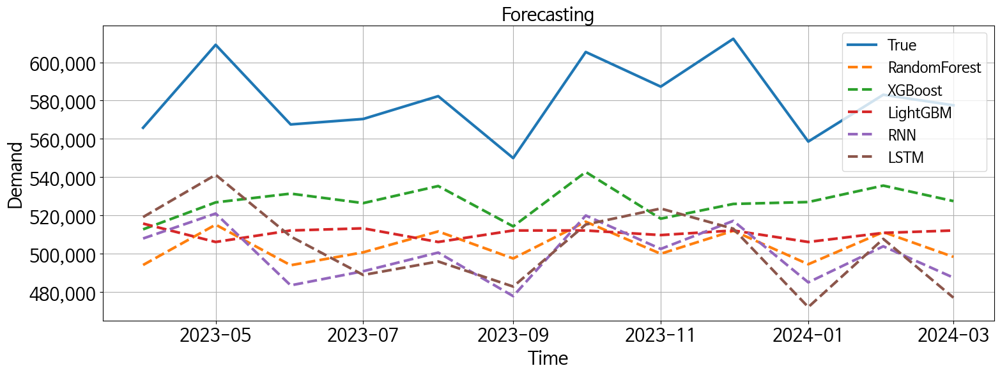

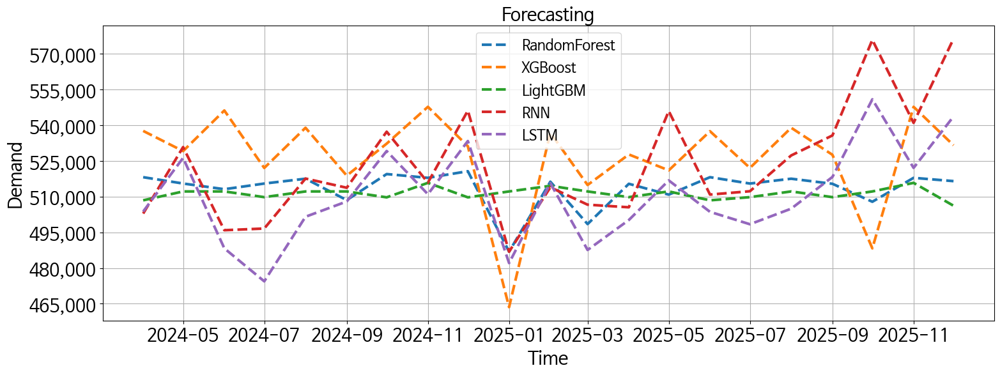

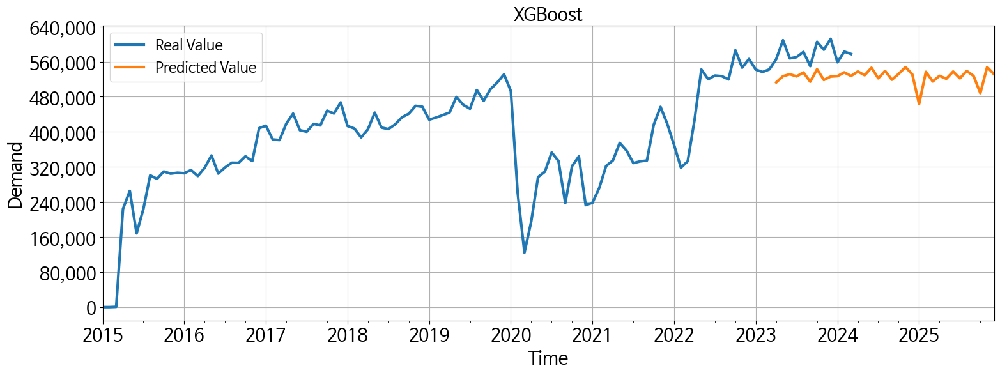

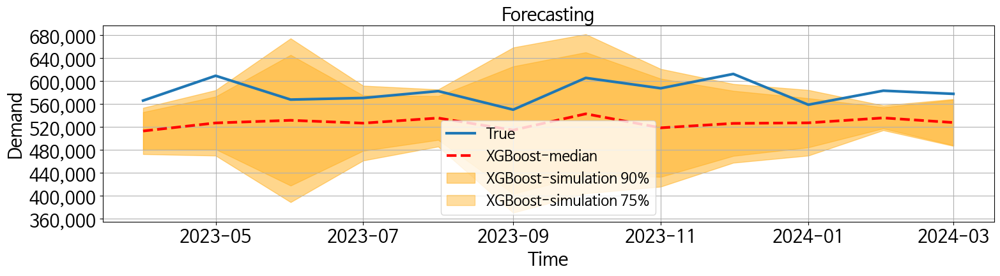

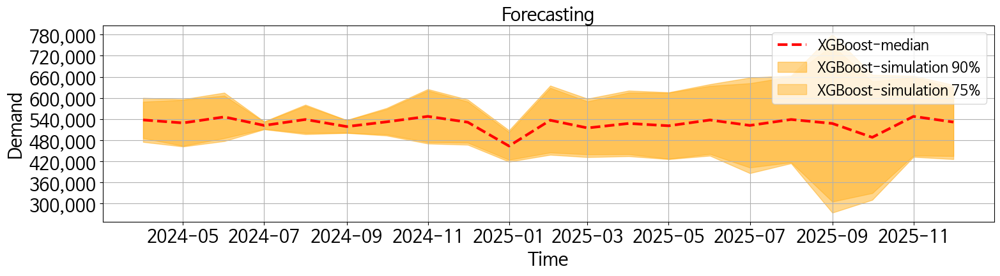

전체 전라선


[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name         | Type          | Params | Mode 
-------------------------------------------------------
0 | loss         | MQLoss        | 5      | train
1 | padder_train | ConstantPad1d | 0      | train
2 | scaler       | TemporalNorm  | 0      | train
3 | mlp          | ModuleList    | 4.6 M  | train
4 | out          | Linear        | 169 K  | train
-------------------------------------------------------
4.7 M     Trainable params
5         Non-trainable params
4.7 M     Total params
18.936    Total estimated model params size (MB)
7         Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | RNN           | 126 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
373 K     Trainable params
5         Non-trainable params
373 K     Total params
1.494     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | LSTM          | 505 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
752 K     Trainable params
5         Non-trainable params
752 K     Total params
3.010     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | GRU           | 379 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
626 K     Trainable params
5         Non-trainable params
626 K     Total params
2.505     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

,MSE,RMSE,MSPE,MAE,MAPE,MedAE,MedAPE
LSTM,"5,640,429,991.7969","75,102.7962",0.0099,"73,611.3854",0.0977,"71,753.4375",0.0992
XGBoost,"7,029,472,778.8454","83,841.9512",0.0114,"75,523.3906",0.0979,"75,369.3750",0.0997
RNN,"7,838,615,063.4427","88,535.9535",0.0134,"86,133.4271",0.1136,"85,643.8750",0.1120
GRU,"9,050,605,179.3815","95,134.6687",0.0155,"89,904.0729",0.1184,"91,753.8438",0.1186
MLP,"20,367,774,140.8284","142,715.7109",0.0364,"110,675.3281",0.1469,"72,745.2188",0.0988
LightGBM,"14,658,785,235.4819","121,073.4704",0.0243,"113,336.6031",0.1476,"119,096.9827",0.1584
RandomForest,"19,748,358,782.2725","140,528.8539",0.0330,"133,666.4433",0.1748,"138,089.9900",0.1868
CatBoost,"26,395,718,077.5636","162,467.5909",0.0450,"158,924.2115",0.2093,"168,611.1595",0.2225


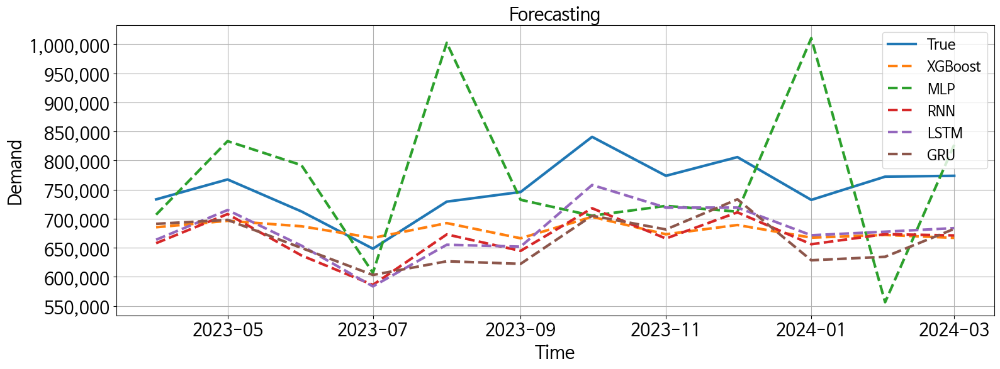

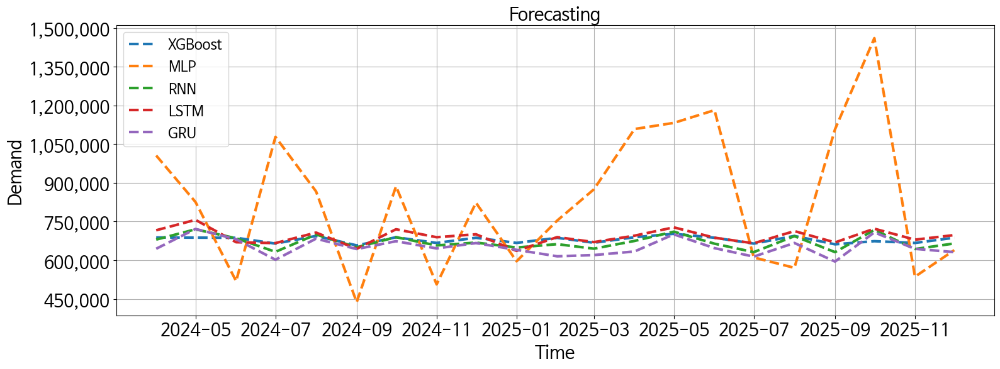

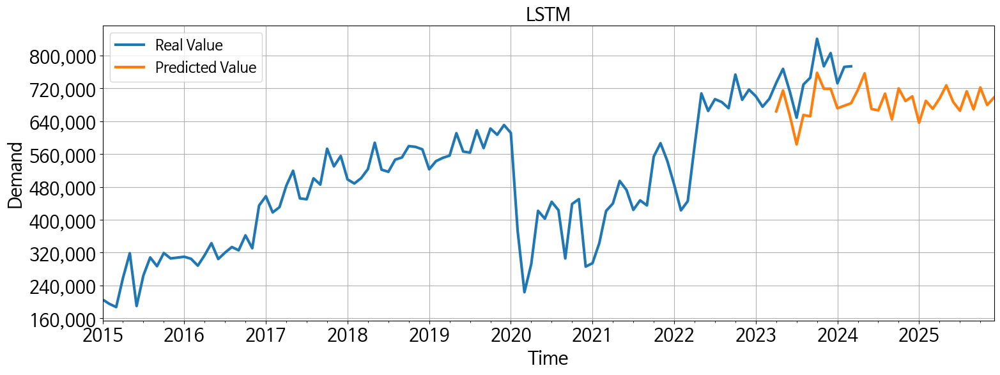

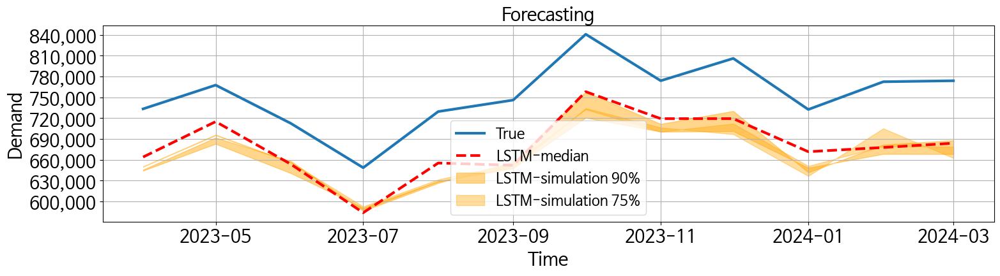

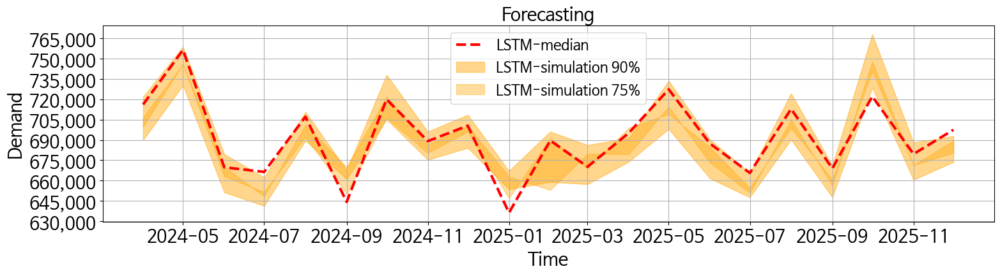

전체 호남선


[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: Seed set to 1
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name         | Type          | Params | Mode 
-------------------------------------------------------
0 | loss         | MQLoss        | 5      | train
1 | padder_train | ConstantPad1d | 0      | train
2 | scaler       | TemporalNorm  | 0      | train
3 | mlp          | ModuleList    | 4.6 M  | train
4 | out          | Linear        | 169 K  | train
-------------------------------------------------------
4.7 M     Trainable params
5         Non-trainable params
4.7 M     Total params
18.936    Total estimated model params size (MB)
7         Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | RNN           | 126 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
373 K     Trainable params
5         Non-trainable params
373 K     Total params
1.494     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | LSTM          | 505 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
752 K     Trainable params
5         Non-trainable params
752 K     Total params
3.010     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | GRU           | 379 K  | train
4 | context_adapter | Linear        | 240 K  | train
5 | mlp_decoder     | MLP           | 6.4 K  | train
----------------------------------------------------------
626 K     Trainable params
5         Non-trainable params
626 K     Total params
2.505     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

,MSE,RMSE,MSPE,MAE,MAPE,MedAE,MedAPE
XGBoost,"4,070,652,039.9274","63,801.6617",0.0037,"54,371.5990",0.0522,"52,382.5938",0.0517
LightGBM,"5,279,891,370.4835","72,662.8610",0.0048,"63,927.3960",0.0616,"56,403.8132",0.0565
RandomForest,"5,486,097,897.6960","74,068.1976",0.0050,"65,635.0900",0.0631,"64,936.8650",0.0647
CatBoost,"4,916,135,436.7111","70,115.1584",0.0045,"64,803.2490",0.0627,"69,615.8782",0.0672
RNN,"12,967,059,173.1149","113,872.9958",0.0123,"112,667.1302",0.1102,"116,903.5938",0.1110
LSTM,"15,522,657,572.5114","124,589.9578",0.0150,"123,722.5677",0.1215,"122,533.5938",0.1214
GRU,"17,364,582,132.1058","131,774.7401",0.0166,"131,100.2240",0.1285,"130,866.1250",0.1273
MLP,"68,500,607,670.8880","261,726.2075",0.0640,"219,782.2500",0.2129,"229,210.9688",0.2199


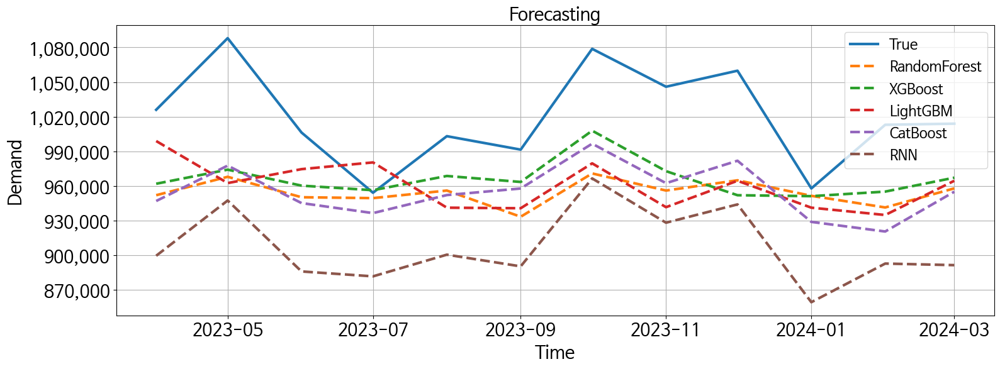

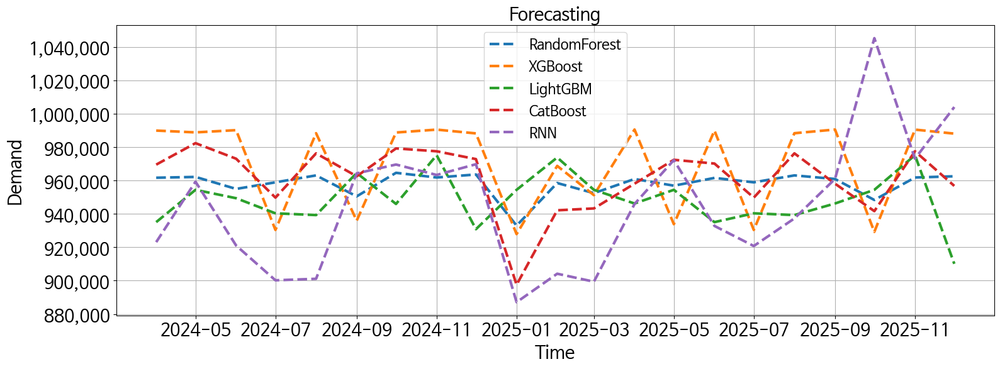

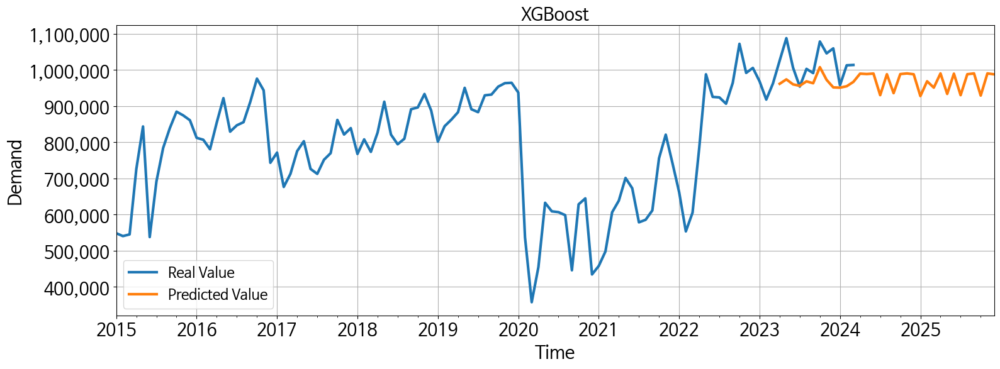

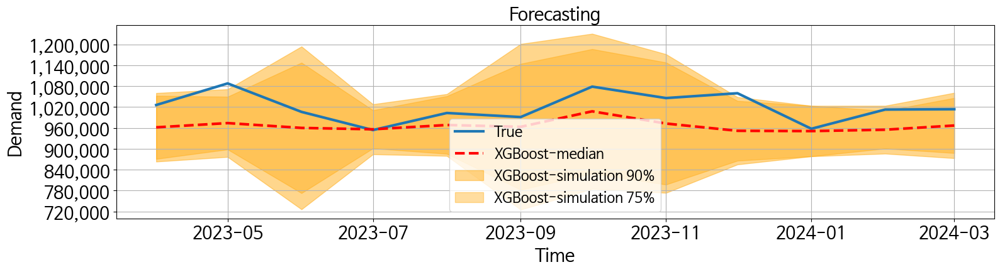

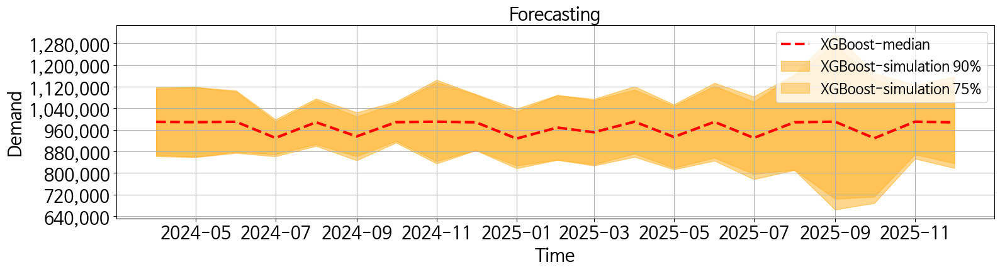

In [3]:
## 모델링변수설정
LAG_LENGTH = 12
X_col_FUTR = ['일수', '주말수', '주중수', '공휴일수', '명절수',
              '공급좌석합계수', '승차율', '열차운행횟수',
              '사망자수', '접종시작자수', '격리된자수', '정부대응정도', 
              '확진자수', '접종완료자수', '코로나진행정도', '국가이동제한정도']
X_col_HISTR = 'auto'
X_col_STATIC_ML = []
X_col_STATIC_DL = None

# 대상선정
for target_line in lines:
    # 저장오픈
    if LAG_LENGTH == None:
        save_name_feature = 'FUTR'+str(len(X_col_FUTR))+'+'+'LAG0'
    else:
        save_name_feature = 'FUTR'+str(len(X_col_FUTR))+'+'+'LAG'+str(LAG_LENGTH)
    save_name = 'Forecasting_'+target_line+'_'+save_name_feature+'.xlsx'
    with pd.ExcelWriter(os.path.join(os.getcwd(), 'Result', save_name), engine='xlsxwriter') as writer:
        for target_dow in dows:
            print(target_dow, target_line)
            
            # 데이터로딩 및 전처리
            df_sub = df[(df['전체주중주말'] == target_dow) & (df['주운행선'] == target_line)].iloc[:,2:]
            df_train, df_validate, df_test, X_colname = preprocessing_ktx(df_sub, Y_colname=Y_colname, X_delete=X_delete,
                                                                          lag_length=LAG_LENGTH, date_splits=DATE_SPLITS)

            # 모델링
            ## ML
            model_ml, Y_pred_ml = modeling_MLForecast(df_train, pd.concat([df_validate, df_test], axis=0), 
                                                      Y_colname=Y_colname, 
                                                      X_col_FUTR=X_col_FUTR, X_col_STATIC=X_col_STATIC_ML,
                                                      ALGORITHMS=ALGOS_ML, CONFIG_CUSTOM=CONFIG_CUSTOM_ML,
                                                      INTERVAL_LEVELS=LEVELS, INTERVAL_WINDOW=N_WINDOWS,
                                                      RANDOM_STATE=RANDOM_STATE, VERBOSITY=VERBOSITY)
            ## DL
            model_dl, Y_pred_dl = modeling_NeuralForecast(df_train, pd.concat([df_validate, df_test], axis=0), 
                                                          Y_colname=Y_colname, 
                                                          X_col_FUTR=X_col_FUTR, X_col_HISTR=X_col_HISTR, X_col_STATIC=X_col_STATIC_DL,
                                                          ALGORITHMS=ALGOS_DL, CONFIG_CUSTOM=CONFIG_CUSTOM_DL)

            # 예측정리
            Y_pred = pd.concat([Y_pred_ml, Y_pred_dl.iloc[:,2:]], axis=1)

            # 평가/검증
            Y_valpred, Y_tepred = Y_pred.iloc[:df_validate.shape[0],:], Y_pred.iloc[df_validate.shape[0]:,:]
            ## Evaluation of validate pairs
            scores = evaluation_reg_Metrics_DF(Y_valpred.iloc[:,1:], ranking=RANKING, ranking_metric=RANKING_METRIC)
            display(scores)
            ## Prediction plot
            score_top = list(scores.iloc[:5].index)
            score_filter = [col for col in Y_valpred.columns if col.split('-')[0] in score_top]
            evaluation_reg_PredPlot_DF(Y_valpred.loc[:,['y']+score_filter], xlabel='Time', ylabel='Demand')
            evaluation_reg_PredPlot_DF(Y_tepred.loc[:,score_filter], xlabel='Time', ylabel='Demand')
            evaluation_time_PredPlot(pd.concat([df_train[Y_colname], df_validate[Y_colname]], axis=0), 
                                     pd.concat([Y_valpred[scores.index[0]], Y_tepred[scores.index[0]]], axis=0), 
                                     Y_pred_index=True, 
                                     title=scores.index[0], xlabel='Time', ylabel='Demand', visual_package='matolotlib')
            evaluation_reg_PredPlot_DF(Y_valpred[['y']+[col for col in Y_tepred.columns if col.split('-')[0] == scores.index[0]]], levels=True, xlabel='Time', ylabel='Demand')
            evaluation_reg_PredPlot_DF(Y_tepred[[col for col in Y_tepred.columns if col.split('-')[0] == scores.index[0]]], levels=True, xlabel='Time', ylabel='Demand')

            # 정리 및 저장
            scores.to_excel(writer, sheet_name='Performance_'+target_dow) 
            Y_pred = Y_pred[['unique_id'] + [col for col in Y_pred.columns if col.split('-')[-1].isalpha()]]
            Y_pred.columns = ['unique_id'] + [col.split('-')[0] for col in Y_pred.columns if col.split('-')[-1].isalpha()]
            Y_pred = Y_pred[list(Y_pred.columns[:2]) + list(scores.index)]
            Y_pred.to_excel(writer, sheet_name='Forecasting_'+target_dow)          

# Optimization

In [4]:
# 데이터로딩
folder_location = os.path.join(os.getcwd(), 'Result', folder_result)
Y_direct_total, Y_direct_top = pd.DataFrame(), pd.DataFrame()
Y_eval_total, Y_eval_top = pd.DataFrame(), pd.DataFrame()
for target_line in lines:
    files = [os.path.join(folder_location, file) for file in os.listdir(folder_location) if file.split('.')[0].split('_')[1] == target_line]
    for target_dow in dows:
        Y_direct, Y_eval_temp = [], pd.DataFrame()
        # 검증
        df_sub = df[(df['전체주중주말'] == target_dow) & (df['주운행선'] == target_line)].iloc[:,2:]
        Y_real = df_sub.set_index('운행년월')[Y_colname]
        for file in files:
            num_feature = int(file.split('.')[0].split('_')[-1].split('+')[0].split('FUTR')[1]) + int(file.split('.')[0].split('_')[-1].split('+')[1].split('LAG')[1])
            ## 분석적 검증
            Y_perf = pd.read_excel(file, sheet_name='Performance_'+target_dow, index_col=0)[['MSPE', 'MAPE', 'MedAPE']].iloc[:n_top_algo,:]
            Y_direct.append([target_line, target_dow, file.split('.')[0].split('_')[-1], num_feature, Y_perf.index[0],
                              Y_perf.iloc[0,:][0], Y_perf.iloc[0,:][1], Y_perf.iloc[0,:][2], Y_perf.mean(axis=0)['MAPE']])
            ## 현업 검증
            Y_pred = pd.read_excel(file, sheet_name='Forecasting_'+target_dow, index_col=0)
            Y_eval = evaluation_year_ktx(target_line, target_dow, Y_real, Y_pred, year_prediction, year_comparison)
            Y_eval['전처리방향'] = file.split('.')[0].split('_')[-1]
            Y_eval['사용변수수'] = num_feature
            
            # 정리
            ## 결과붙이기
            Y_eval_temp = pd.concat([Y_eval_temp, Y_eval.iloc[[0],:]], axis=0)
        Y_direct = pd.DataFrame(Y_direct)
        Y_direct.columns = ['주운행선', '전체주중주말', '전처리방향', '변수수', '알고리즘', 'MSPE', 'MAPE', 'MedAPE', 'Top_Average']
        Y_direct_total = pd.concat([Y_direct, Y_direct_total], axis=0)
        Y_eval_total = pd.concat([Y_eval_total, Y_eval_temp], axis=0)
        ## 최적필터링
        Y_direct_good = Y_direct.loc[:,criteria].argmin()
        Y_direct_top = pd.concat([Y_direct_top, Y_direct.iloc[[Y_direct_good],:]], axis=0)
        Y_eval_top = pd.concat([Y_eval_top, Y_eval_temp.iloc[[Y_direct_good],:]], axis=0)
Y_direct_total = Y_direct_total.sort_values(by=['주운행선', '전체주중주말', '변수수'])

display(Y_direct_top, Y_eval_top)

,주운행선,전체주중주말,전처리방향,변수수,알고리즘,MSPE,MAPE,MedAPE,Top_Average
0,경부선,전체,FUTR16+LAG12,28,LightGBM,0.0030,0.0439,0.0279,0.0493
0,경전선,전체,FUTR16+LAG12,28,LightGBM,0.0094,0.0935,0.0922,0.1063
0,동해선,전체,FUTR16+LAG12,28,XGBoost,0.0091,0.0918,0.0840,0.1144
0,전라선,전체,FUTR16+LAG12,28,LSTM,0.0099,0.0977,0.0992,0.1030
0,호남선,전체,FUTR16+LAG12,28,XGBoost,0.0037,0.0522,0.0517,0.0590


,,2019년,2024년,2025년,증감율%(2019-2025),증감율%(2024-2025),알고리즘순위,전처리방향,사용변수수
주운행선,전체주중주말,,,,,,,,
경부선,전체,"3,000,063.8333","3,418,760.3333","3,261,318.7958",8.7083,-4.6052,LightGBM,FUTR16+LAG12,28
경전선,전체,"552,301.5833","675,125.3333","624,792.0888",13.1252,-7.4554,LightGBM,FUTR16+LAG12,28
동해선,전체,"470,230.5833","573,079.6667","521,482.1562",10.8992,-9.0035,XGBoost,FUTR16+LAG12,28
전라선,전체,"580,489.3333","759,475.6667","687,732.8594",18.4747,-9.4464,LSTM,FUTR16+LAG12,28
호남선,전체,"905,065.5833","994,879.6667","964,903.8854",6.6115,-3.0130,XGBoost,FUTR16+LAG12,28


# Forecasting

전체 경부선


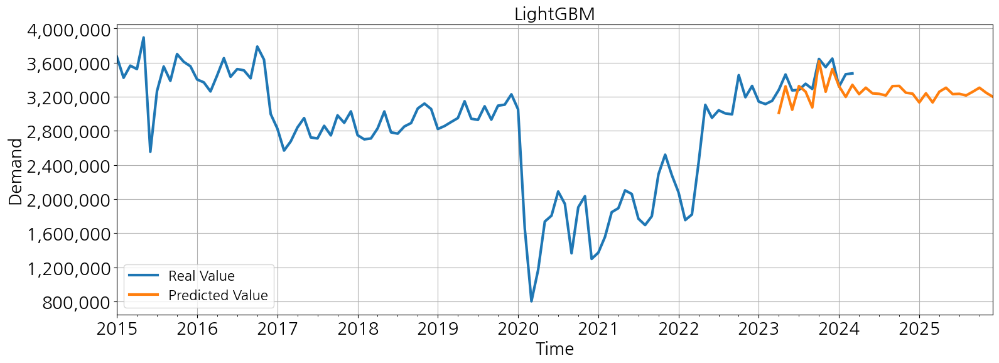

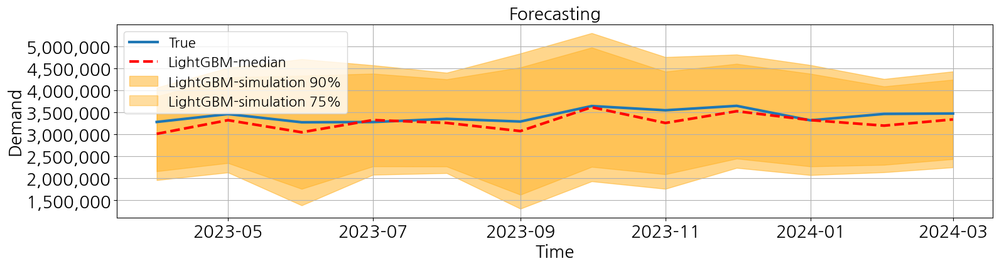

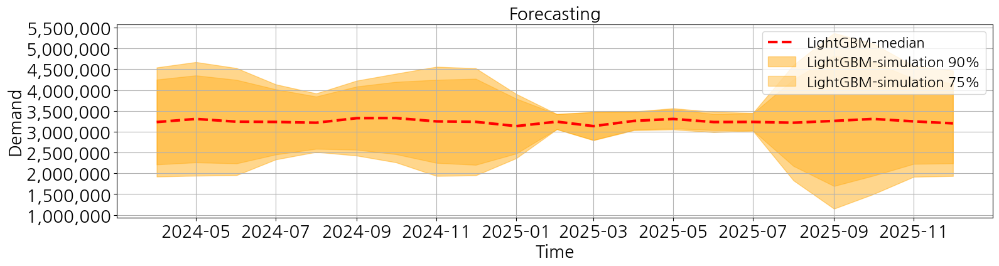

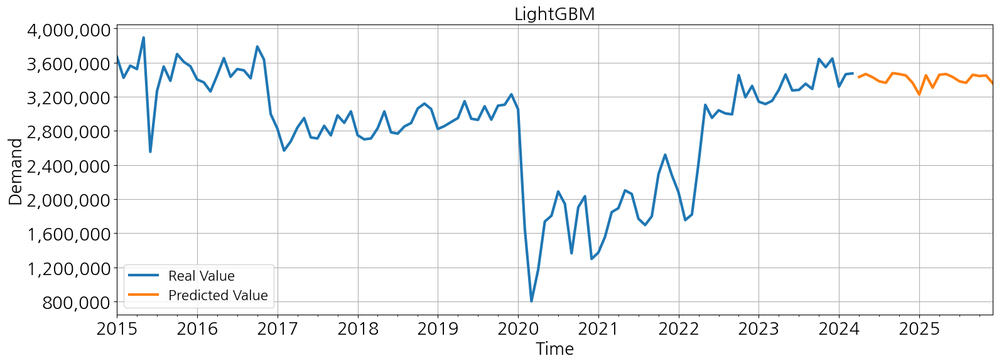

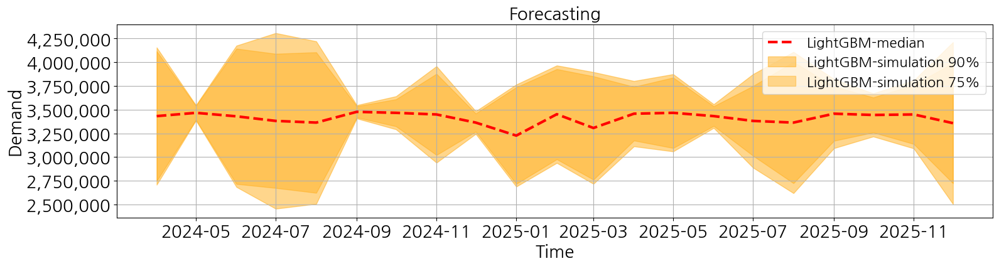

전체 경전선


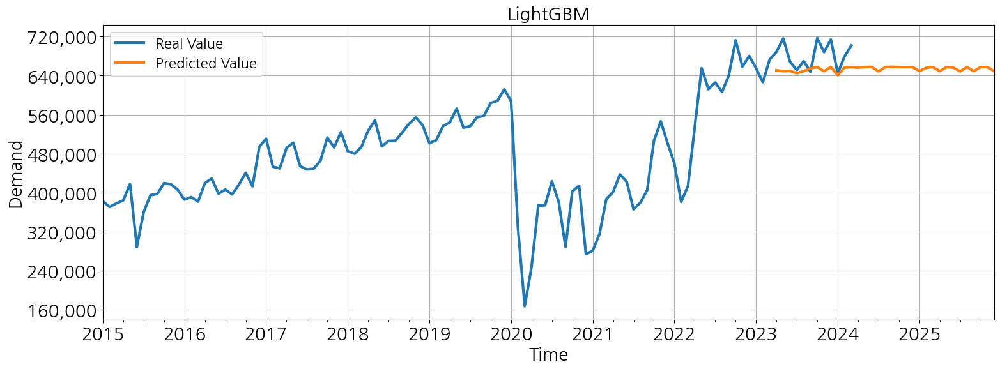

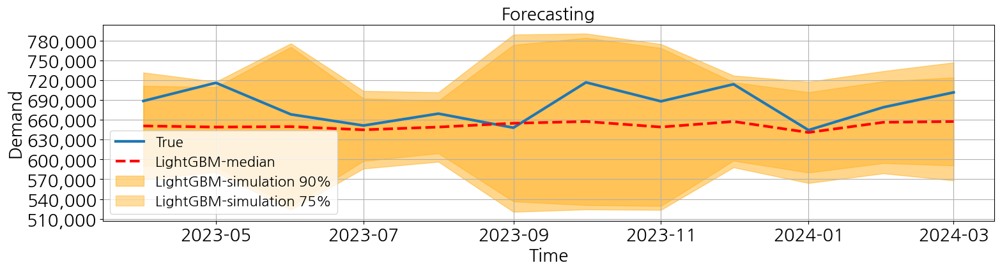

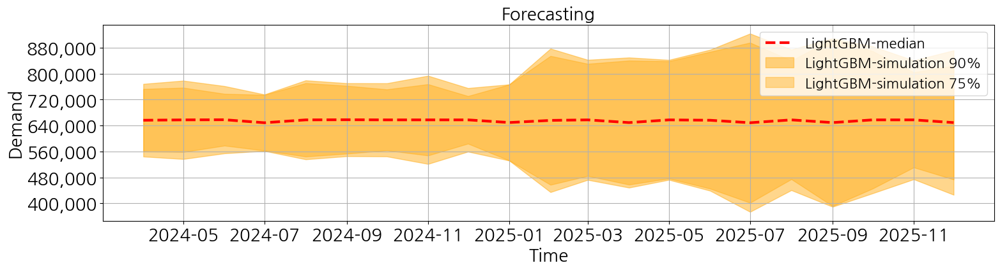

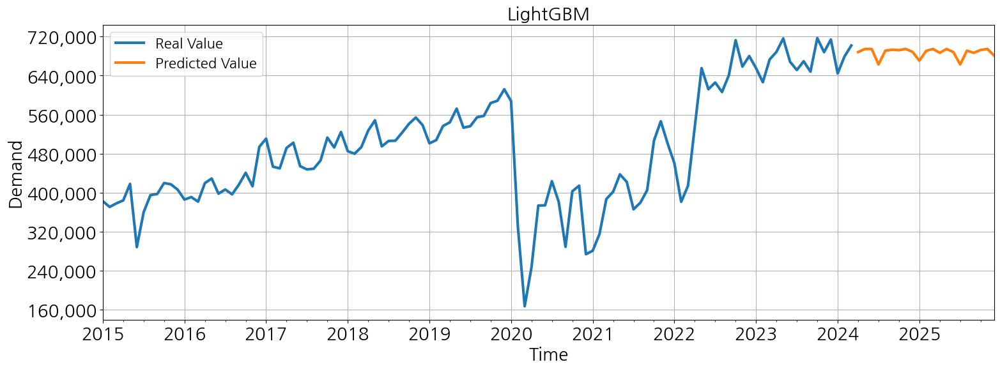

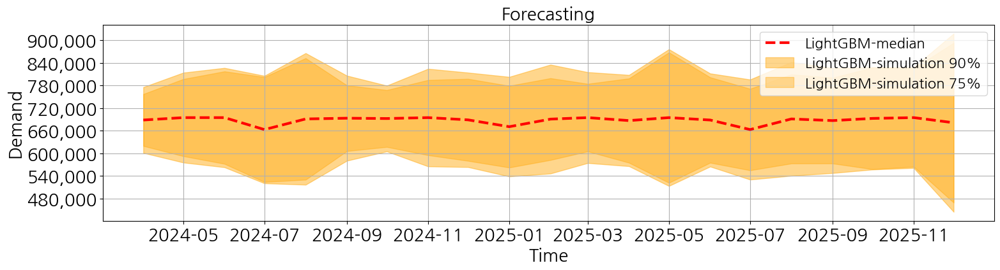

전체 동해선


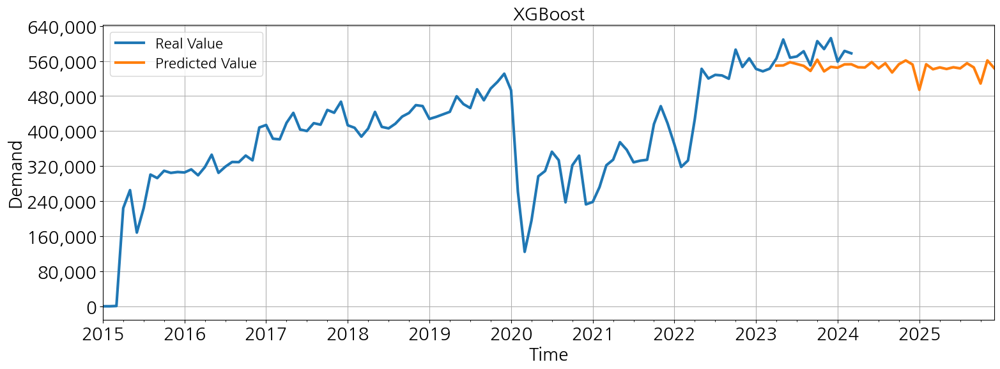

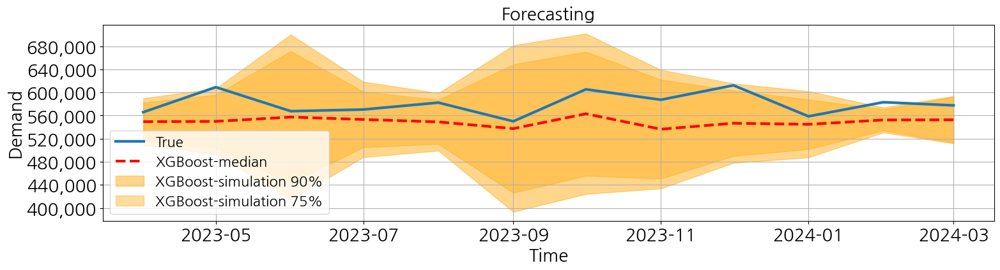

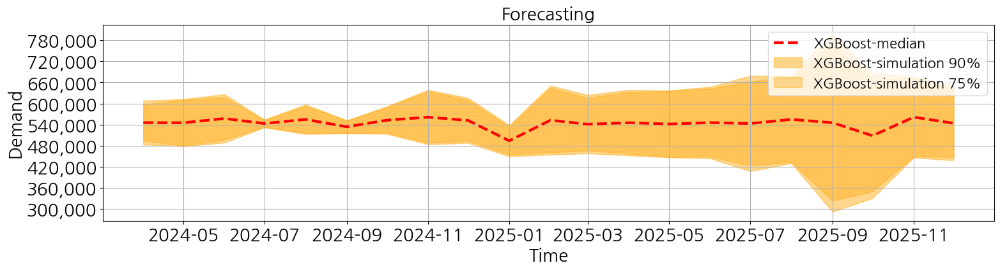

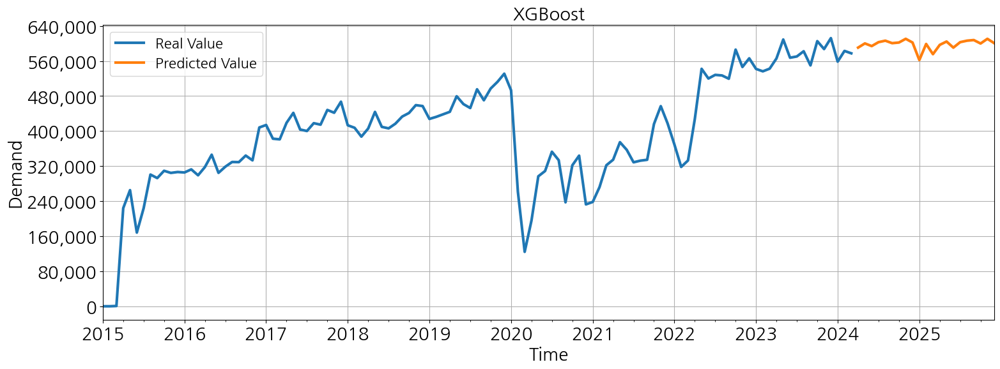

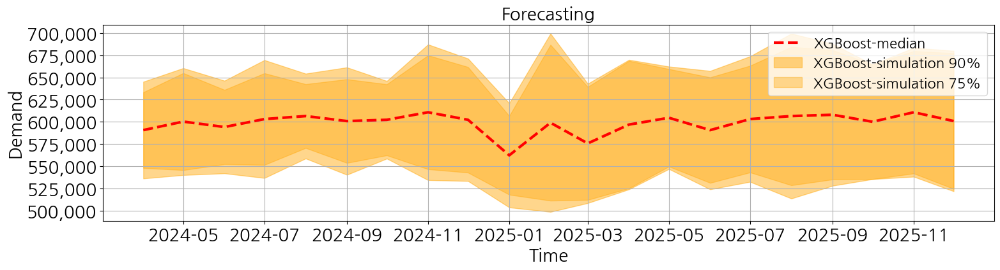

[Kss]: Seed set to 1
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | LSTM          | 502 K  | train
4 | context_adapter | Linear        | 153 K  | train
5 | mlp_decoder     | MLP           | 4.8 K  | train
----------------------------------------------------------
660 K     Trainable params
5         Non-trainable params
660 K     Total params
2.643     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


전체 전라선


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

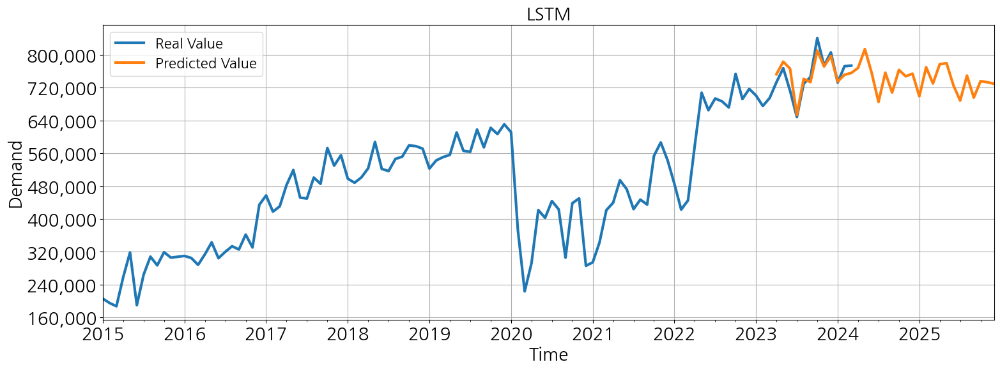

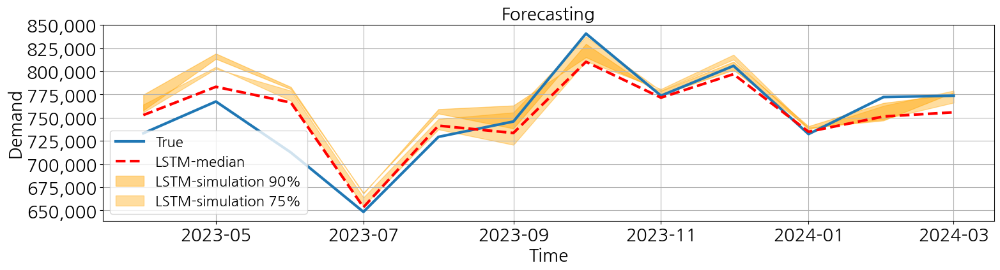

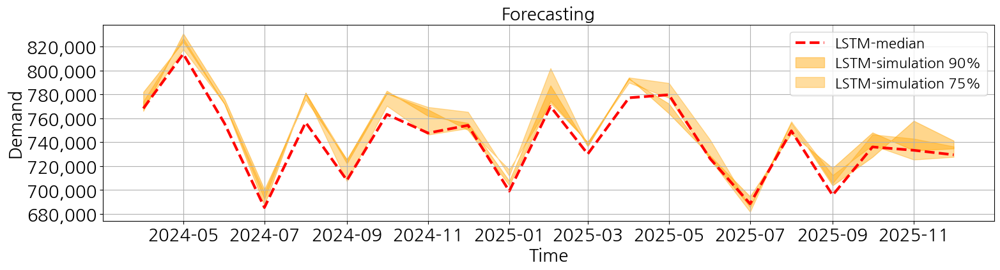

[Kss]: Seed set to 1
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[Kss]: 
  | Name            | Type          | Params | Mode 
----------------------------------------------------------
0 | loss            | MQLoss        | 5      | train
1 | padder          | ConstantPad1d | 0      | train
2 | scaler          | TemporalNorm  | 0      | train
3 | hist_encoder    | LSTM          | 502 K  | train
4 | context_adapter | Linear        | 77.5 K | train
5 | mlp_decoder     | MLP           | 4.8 K  | train
----------------------------------------------------------
584 K     Trainable params
5         Non-trainable params
584 K     Total params
2.339     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                | 0/? [00:00…

Training: |                                                                                       | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

Validation: |                                                                                     | 0/? [00:00…

[Kss]: `Trainer.fit` stopped: `max_steps=1000` reached.
[Kss]: GPU available: True (cuda), used: True
[Kss]: TPU available: False, using: 0 TPU cores
[Kss]: HPU available: False, using: 0 HPUs
[Kss]: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                     | 0/? [00:00…

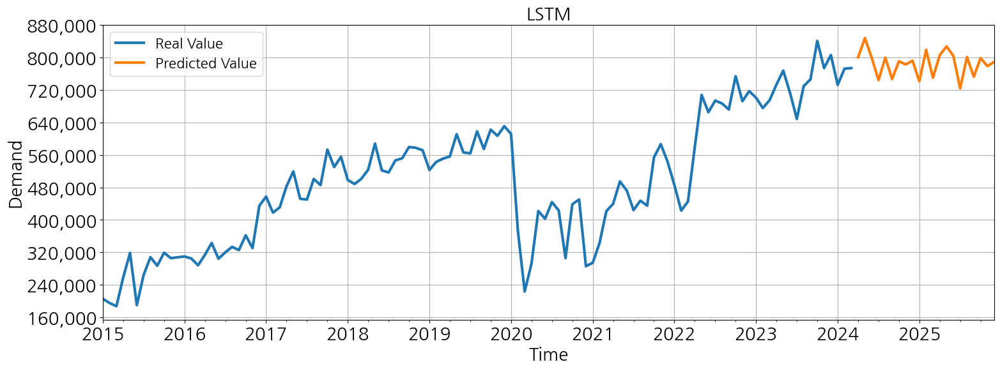

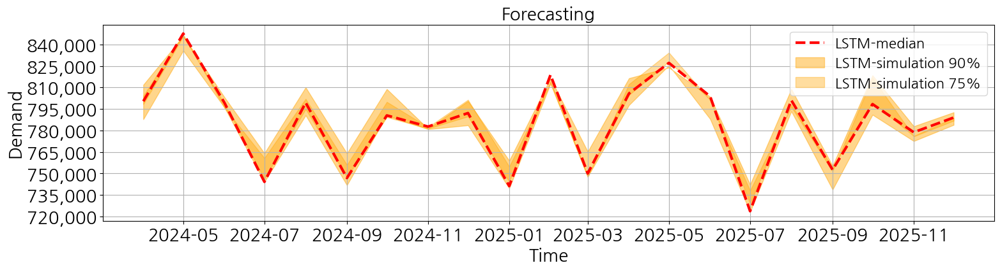

전체 호남선


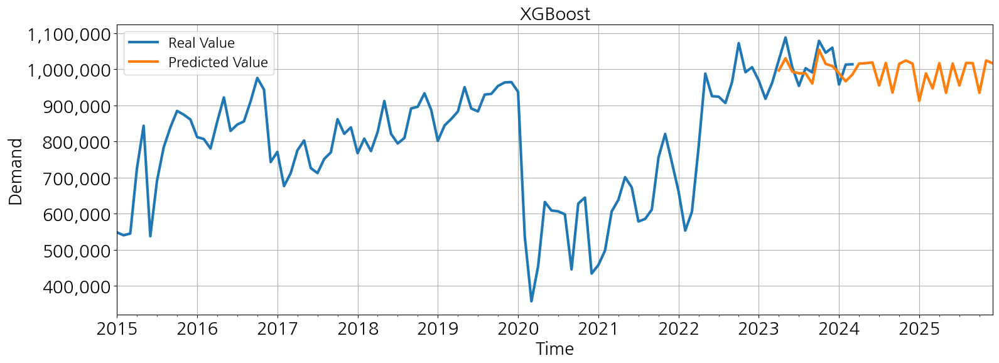

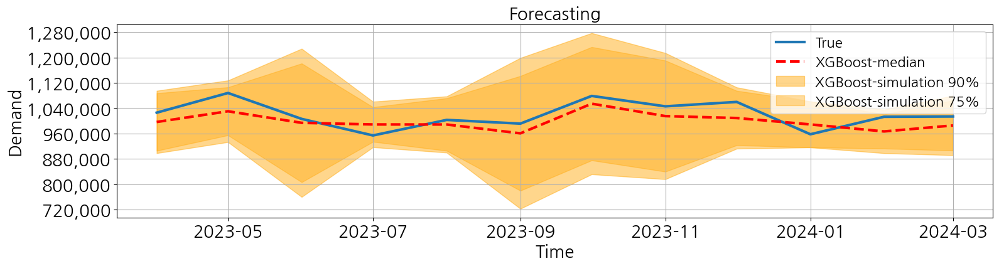

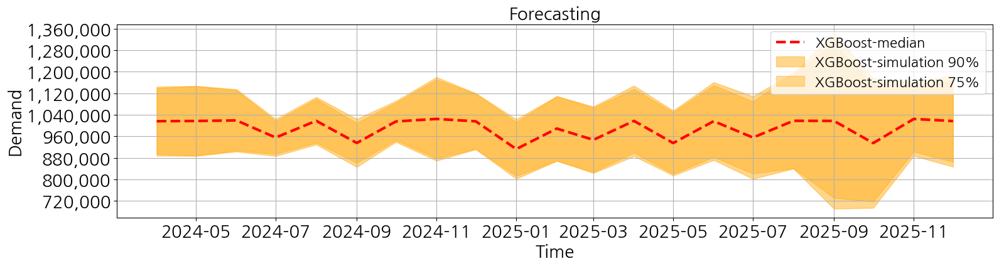

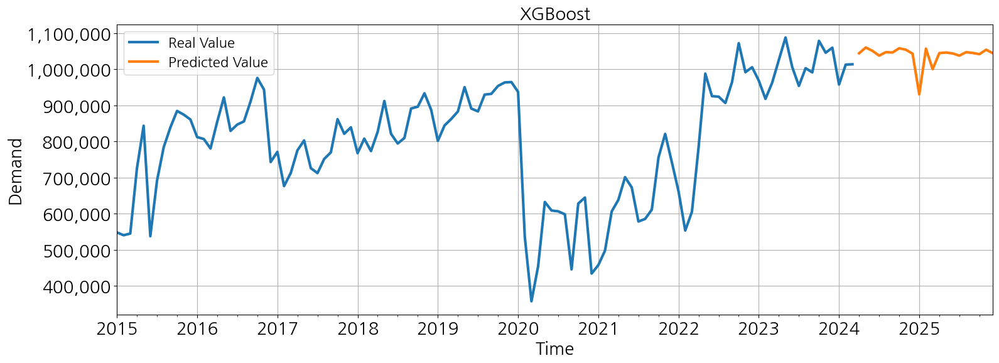

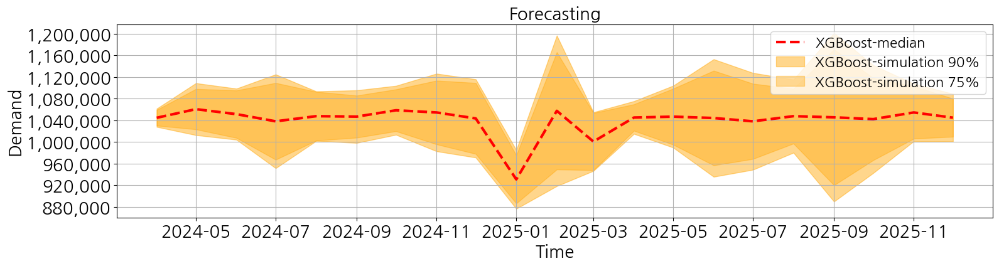

2019년          2024년          2025년  증감율%(2019-2025)  \
주운행선 전체주중주말                                                                 
경부선  전체     3,000,063.8333 3,418,760.3333 3,230,238.9291           7.6723   
     전체     3,000,063.8333 3,418,760.3333 3,399,245.7540          13.3058   
경전선  전체       552,301.5833   675,125.3333   653,788.6153          18.3753   
     전체       552,301.5833   675,125.3333   686,187.4974          24.2415   
동해선  전체       470,230.5833   573,079.6667   539,841.8125          14.8036   
     전체       470,230.5833   573,079.6667   596,461.1875          26.8444   
전라선  전체       580,489.3333   759,475.6667   734,584.2500          26.5457   
     전체       580,489.3333   759,475.6667   782,492.1875          34.7987   
호남선  전체       905,065.5833   994,879.6667   981,807.5000           8.4792   
     전체       905,065.5833   994,879.6667 1,032,872.7500          14.1213   

             증감율%(2024-2025)    알고리즘순위  
주운행선 전체주중주말                             
경부선  전체              -5.5143  LightGBM  
     전체              -0.5708  LightGBM  
경전선  전체              -3.1604  LightGBM  
     전체               1.6385  LightGBM  
동해선  전체              -5.7999   XGBoost  
     전체               4.0800   XGBoost  
전라선  전체              -3.2774      LSTM  
     전체               3.0306      LSTM  
호남선  전체              -1.3139   XGBoost  
     전체               3.8189   XGBoost

In [12]:
# 최적예측
Y_pred_final, Y_eval_final = pd.DataFrame(), pd.DataFrame()
for target_line in lines:
    for target_dow in dows:
        print(target_dow, target_line)

        # 방향
        opt_direct = Y_direct_top[(Y_direct_top['전체주중주말'] == target_dow) & (Y_direct_top['주운행선'] == target_line)]
        ## 변수구분
        Y_colname = '승차인원수'
        X_delete = ['전체주중주말', '주운행선']
        if list(opt_direct['변수수'])[0] == Y_direct_total['변수수'].unique()[0]:
            LAG_LENGTH = None
            X_col_FUTR = ['일수', '주말수', '주중수', '공휴일수', '명절수',
                          '공급좌석합계수', '승차율', '열차운행횟수']
        elif list(opt_direct['변수수'])[0] == Y_direct_total['변수수'].unique()[2]:
            LAG_LENGTH = 12
            X_col_FUTR = ['일수', '주말수', '주중수', '공휴일수', '명절수',
                          '공급좌석합계수', '승차율', '열차운행횟수']          
        elif list(opt_direct['변수수'])[0] == Y_direct_total['변수수'].unique()[1]:
            LAG_LENGTH = None
            X_col_FUTR = ['일수', '주말수', '주중수', '공휴일수', '명절수',
                          '공급좌석합계수', '승차율', '열차운행횟수',
                          '사망자수', '접종시작자수', '격리된자수', '정부대응정도', 
                          '확진자수', '접종완료자수', '코로나진행정도', '국가이동제한정도']
        elif list(opt_direct['변수수'])[0] == Y_direct_total['변수수'].unique()[3]:
            LAG_LENGTH = 12
            X_col_FUTR = ['일수', '주말수', '주중수', '공휴일수', '명절수',
                          '공급좌석합계수', '승차율', '열차운행횟수',
                          '사망자수', '접종시작자수', '격리된자수', '정부대응정도', 
                          '확진자수', '접종완료자수', '코로나진행정도', '국가이동제한정도']
        X_col_HISTR = 'auto'
        X_col_STATIC_ML = []
        X_col_STATIC_DL = None
        ## 기간구분
        DATE_SPLITS = ['2023-03-31', '2024-03-31']
        ## 알고리즘 방향
        ALGOS = list(opt_direct['알고리즘'])

        # 데이터로딩 및 전처리
        df_sub = df[(df['전체주중주말'] == target_dow) & (df['주운행선'] == target_line)].iloc[:,2:]
        df_train, df_validate, df_test, X_colname = preprocessing_ktx(df_sub, Y_colname=Y_colname, X_delete=X_delete,
                                                                      lag_length=LAG_LENGTH, date_splits=DATE_SPLITS)

        # 모델링
        if ALGOS[0] in ALGOS_ML:
            ALGOS_FINAL = ALGOS
            model_ml, Y_pred_ml = modeling_MLForecast(df_train, pd.concat([df_validate, df_test], axis=0), 
                                                      Y_colname=Y_colname, 
                                                      X_col_FUTR=X_col_FUTR, X_col_STATIC=X_col_STATIC_ML,
                                                      ALGORITHMS=ALGOS_FINAL, CONFIG_CUSTOM=CONFIG_CUSTOM_ML,
                                                      INTERVAL_LEVELS=LEVELS, INTERVAL_WINDOW=N_WINDOWS,
                                                      RANDOM_STATE=RANDOM_STATE, VERBOSITY=VERBOSITY)
            Y_pred = Y_pred_ml
        else:
            ALGOS_FINAL = [algo for algo in ALGOS_DL if str(algo).split("'>")[0].split('.')[-1] == ALGOS[0]]
            model_dl, Y_pred_dl = modeling_NeuralForecast(df_train, pd.concat([df_validate, df_test], axis=0), 
                                                          Y_colname=Y_colname, 
                                                          X_col_FUTR=X_col_FUTR, X_col_HISTR=X_col_HISTR, X_col_STATIC=X_col_STATIC_DL,
                                                          ALGORITHMS=ALGOS_FINAL, CONFIG_CUSTOM=CONFIG_CUSTOM_DL)
            Y_pred = Y_pred_dl

        # 평가/검증
        Y_valpred, Y_tepred = Y_pred.iloc[:df_validate.shape[0],:], Y_pred.iloc[df_validate.shape[0]:,:]
        ## Prediction plot
        evaluation_time_PredPlot(pd.concat([df_train[Y_colname], df_validate[Y_colname]], axis=0), 
                                 pd.concat([Y_valpred[ALGOS], Y_tepred[ALGOS]], axis=0), 
                                 Y_pred_index=True, 
                                 title=ALGOS[0], xlabel='Time', ylabel='Demand', visual_package='matolotlib')
        evaluation_reg_PredPlot_DF(Y_valpred.iloc[:,1:], levels=True, xlabel='Time', ylabel='Demand')
        evaluation_reg_PredPlot_DF(Y_tepred.iloc[:,2:], levels=True, xlabel='Time', ylabel='Demand')
        ## 저장
        Y_real = pd.concat([df_train, df_validate, df_test], axis=0)[Y_colname]
        Y_eval = evaluation_year_ktx(target_line, target_dow, Y_real, Y_pred, year_prediction, year_comparison)
        Y_eval_final = pd.concat([Y_eval_final, Y_eval], axis=0)
        Y_pred_final = pd.concat([Y_pred_final, Y_tepred[ALGOS]], axis=1)

        # 데이터로딩 및 전처리
        ## 기간구분
        df_train, df_validate, df_test, X_colname = preprocessing_ktx(df_sub, Y_colname=Y_colname, X_delete=X_delete,
                                                                      lag_length=LAG_LENGTH, date_splits=[DATE_SPLITS[1]])

        # 모델링
        if ALGOS[0] in ALGOS_ML:
            ALGOS_FINAL = ALGOS
            model_ml, Y_pred_ml = modeling_MLForecast(df_train, df_test, 
                                                      Y_colname=Y_colname, 
                                                      X_col_FUTR=X_col_FUTR, X_col_STATIC=X_col_STATIC_ML,
                                                      ALGORITHMS=ALGOS_FINAL, CONFIG_CUSTOM=CONFIG_CUSTOM_ML,
                                                      INTERVAL_LEVELS=LEVELS, INTERVAL_WINDOW=N_WINDOWS,
                                                      RANDOM_STATE=RANDOM_STATE, VERBOSITY=VERBOSITY)
            Y_pred = Y_pred_ml
        else:
            ALGOS_FINAL = [algo for algo in ALGOS_DL if str(algo).split("'>")[0].split('.')[-1] == ALGOS[0]]
            model_dl, Y_pred_dl = modeling_NeuralForecast(df_train, df_test, 
                                                          Y_colname=Y_colname, 
                                                          X_col_FUTR=X_col_FUTR, X_col_HISTR=X_col_HISTR, X_col_STATIC=X_col_STATIC_DL,
                                                          ALGORITHMS=ALGOS_FINAL, CONFIG_CUSTOM=CONFIG_CUSTOM_DL)
            Y_pred = Y_pred_dl

        # 평가/검증
        Y_tepred = Y_pred
        ## Prediction plot
        evaluation_time_PredPlot(df_train[Y_colname], Y_tepred[ALGOS], 
                                 Y_pred_index=True, 
                                 title=ALGOS[0], xlabel='Time', ylabel='Demand', visual_package='matolotlib')
        evaluation_reg_PredPlot_DF(Y_tepred.iloc[:,2:], levels=True, xlabel='Time', ylabel='Demand')     
        ## 저장
        Y_eval = evaluation_year_ktx(target_line, target_dow, Y_real, Y_pred, year_prediction, year_comparison)
        Y_eval_final = pd.concat([Y_eval_final, Y_eval], axis=0)
        Y_pred_final = pd.concat([Y_pred_final, Y_tepred[ALGOS]], axis=1)
## 출력
with pd.ExcelWriter(os.path.join(os.getcwd(), 'Result', save_name_final), engine='xlsxwriter') as writer:
    Y_eval_final.to_excel(writer, sheet_name='Evaluation_byYear')
    Y_pred_final.to_excel(writer, sheet_name='Forecasting')
Y_eval_final

# XAI

전체 경부선


Explanations for Train Dataset:


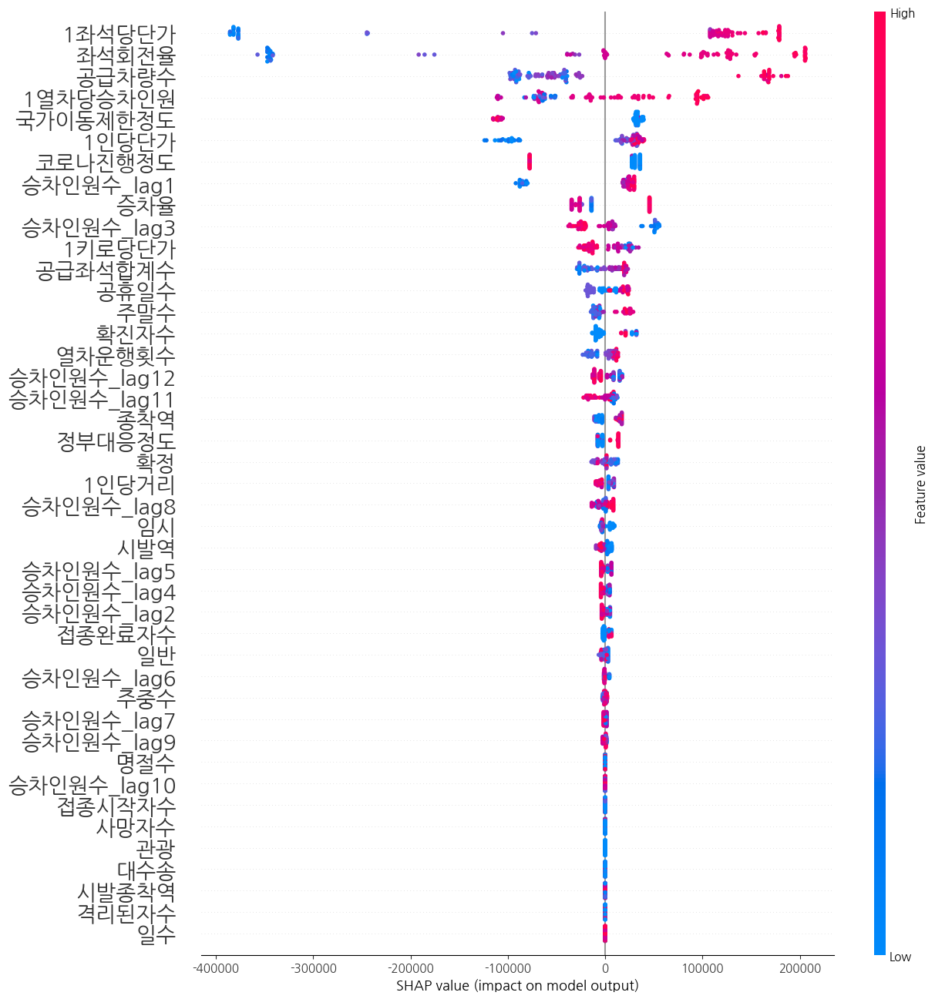

2

Explanations for a Random Test Sample:


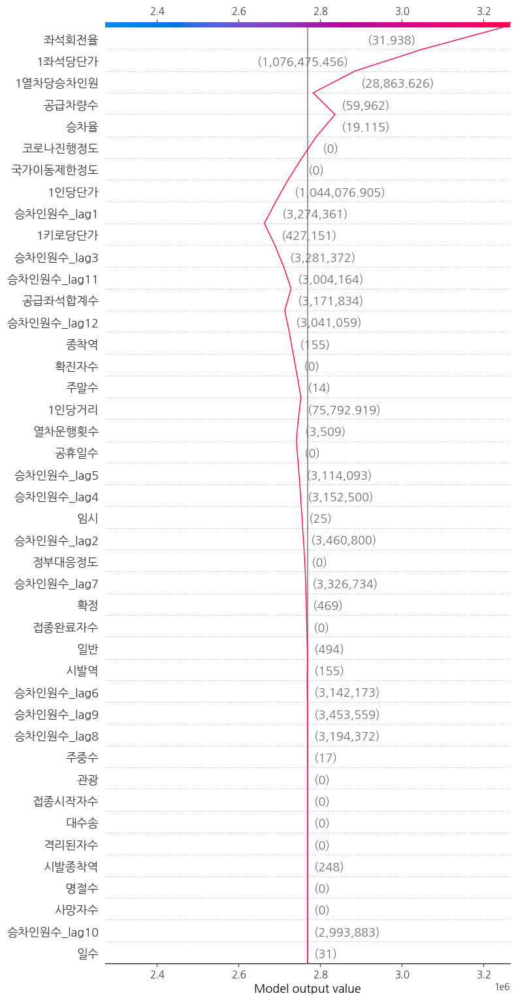

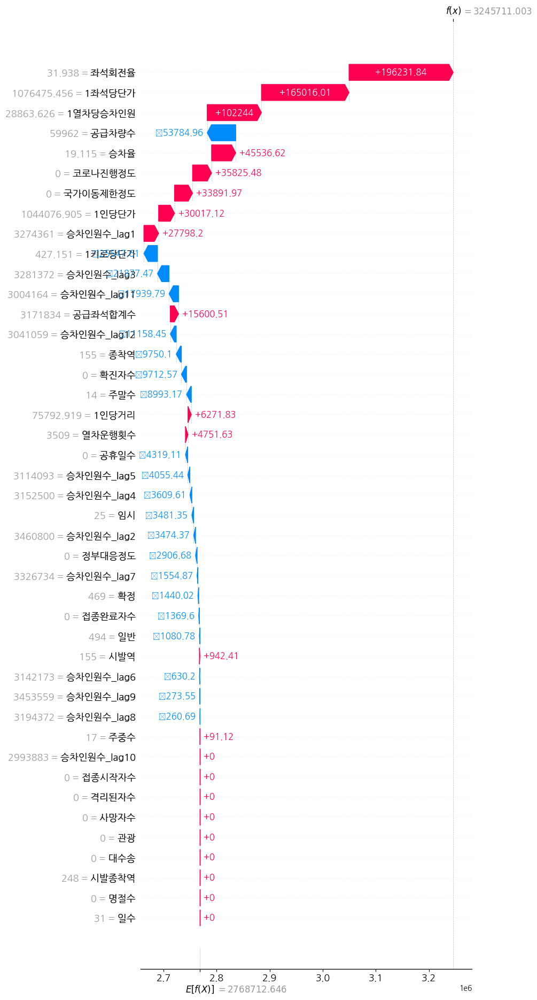

Performance: 


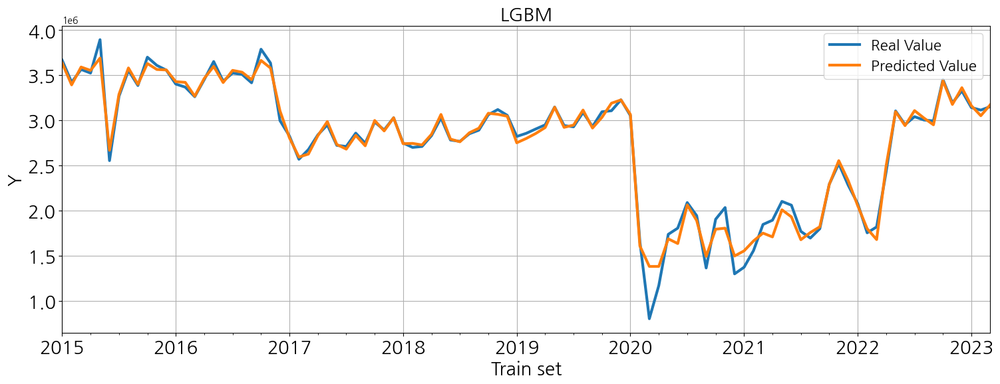

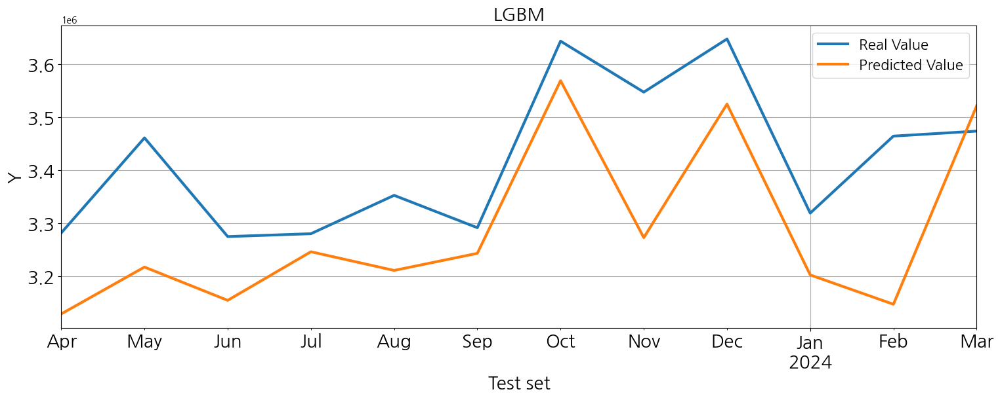

전체 경전선


Explanations for Train Dataset:


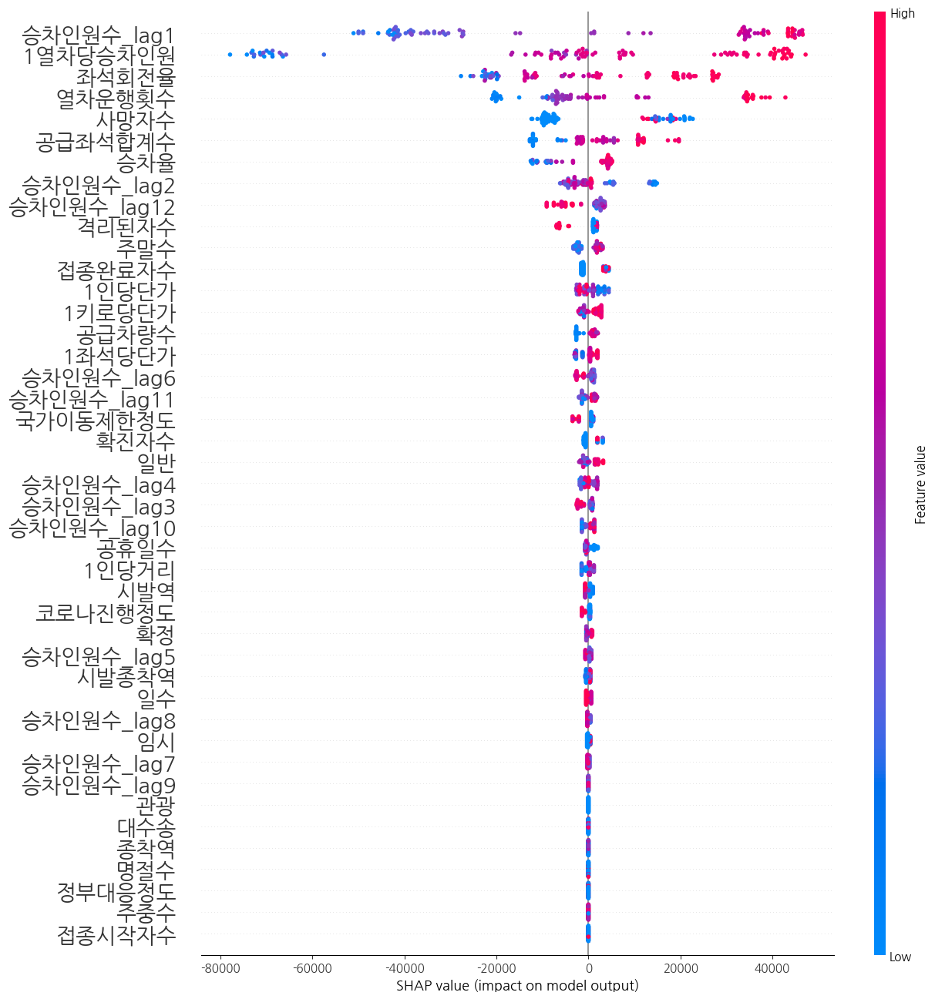

2

Explanations for a Random Test Sample:


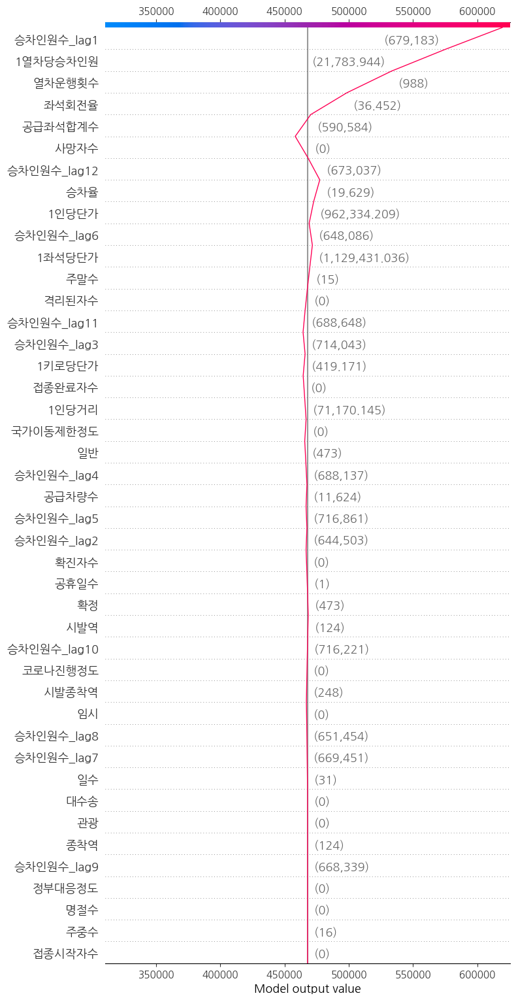

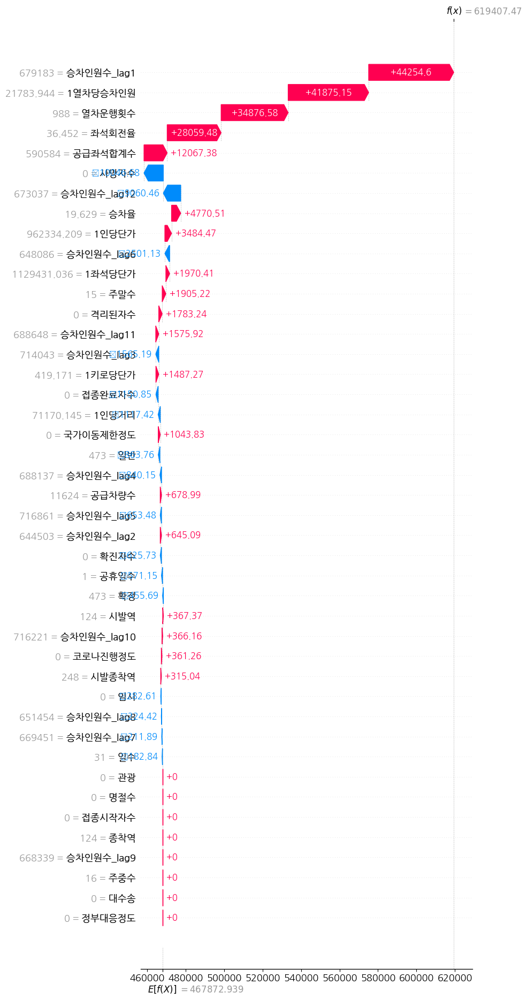

Performance: 


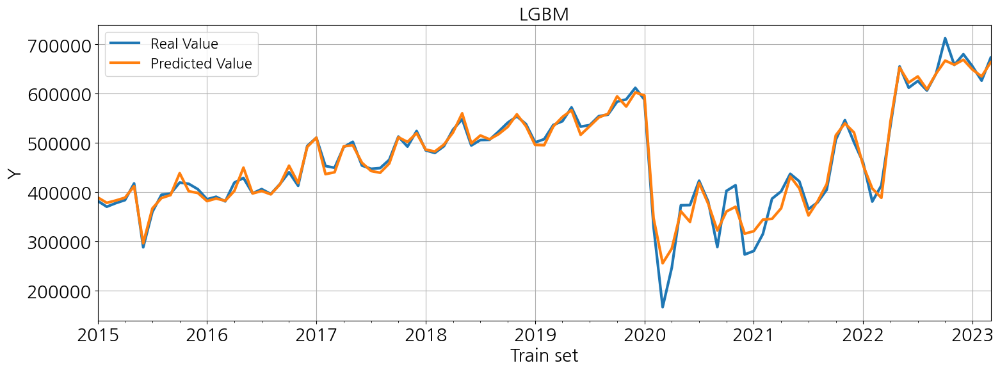

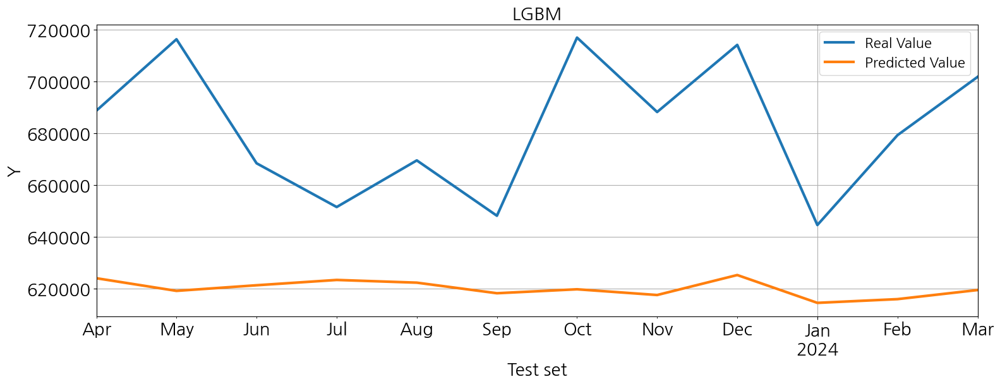

전체 동해선


Explanations for Train Dataset:


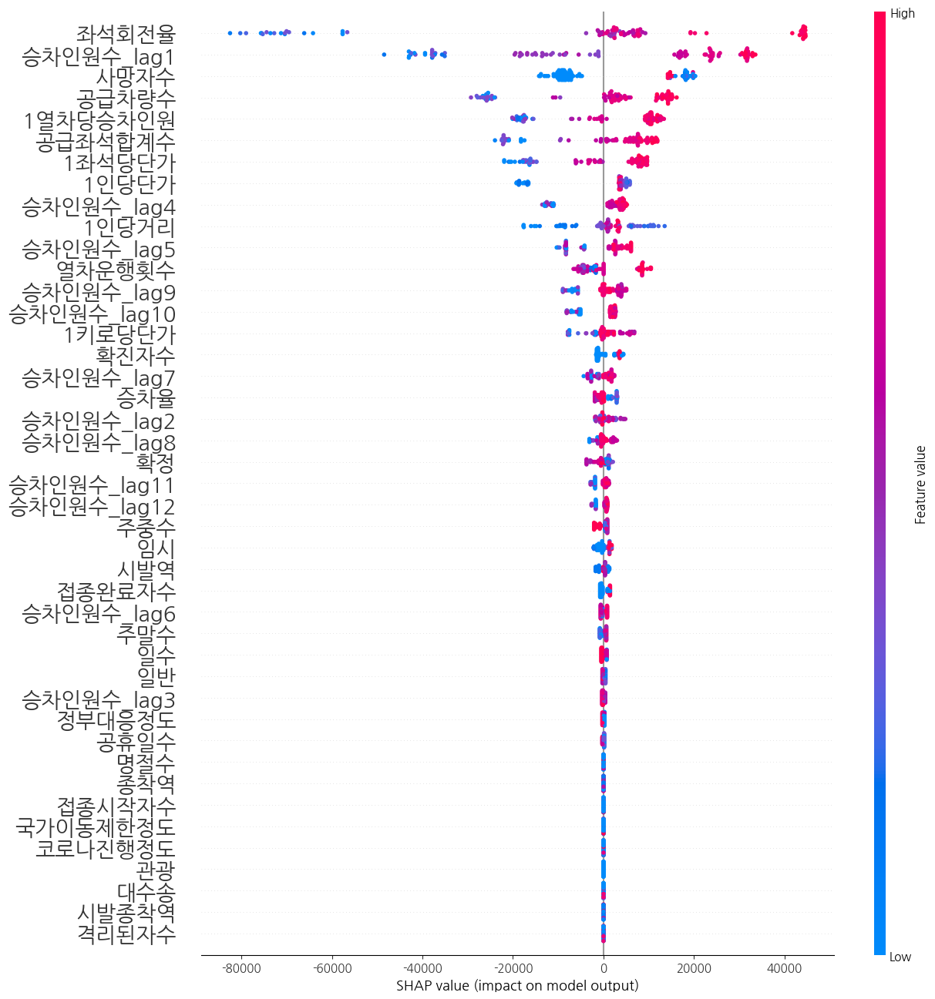

2

Explanations for a Random Test Sample:


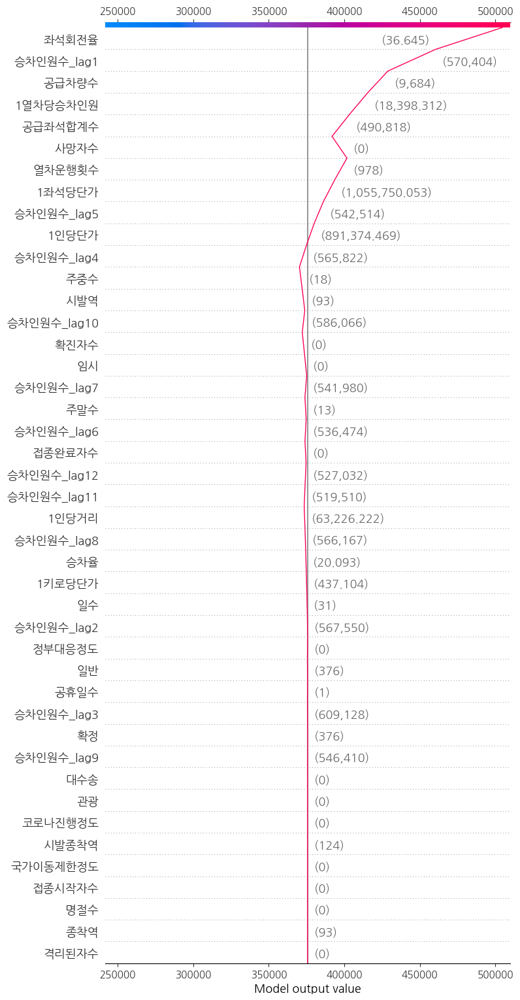

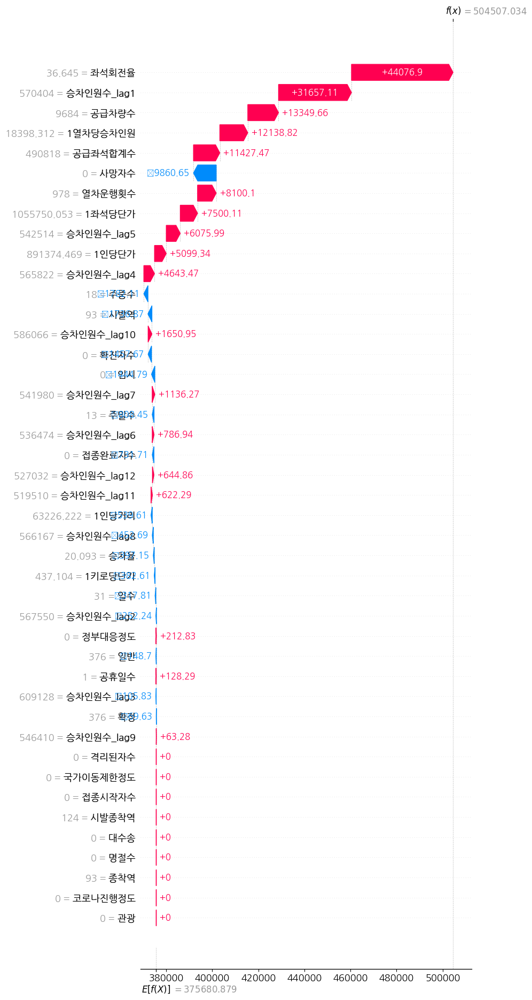

Performance: 


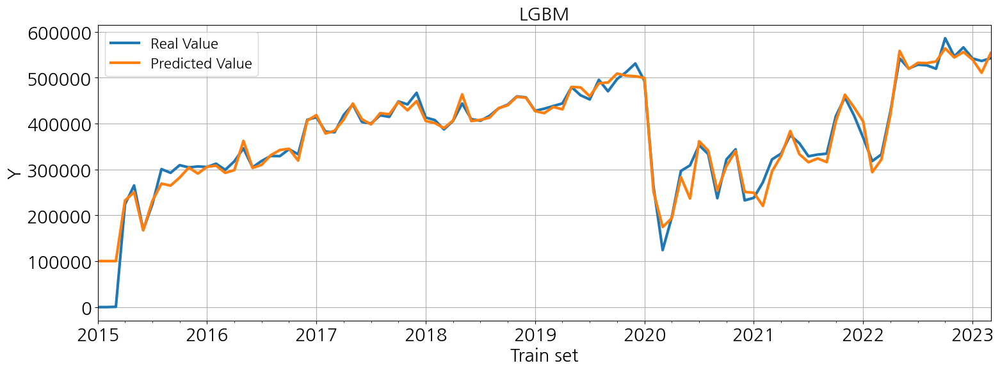

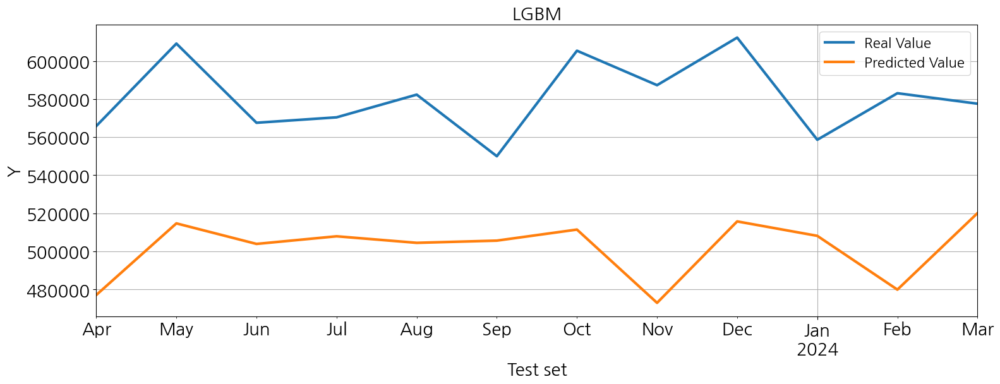

전체 전라선


Explanations for Train Dataset:


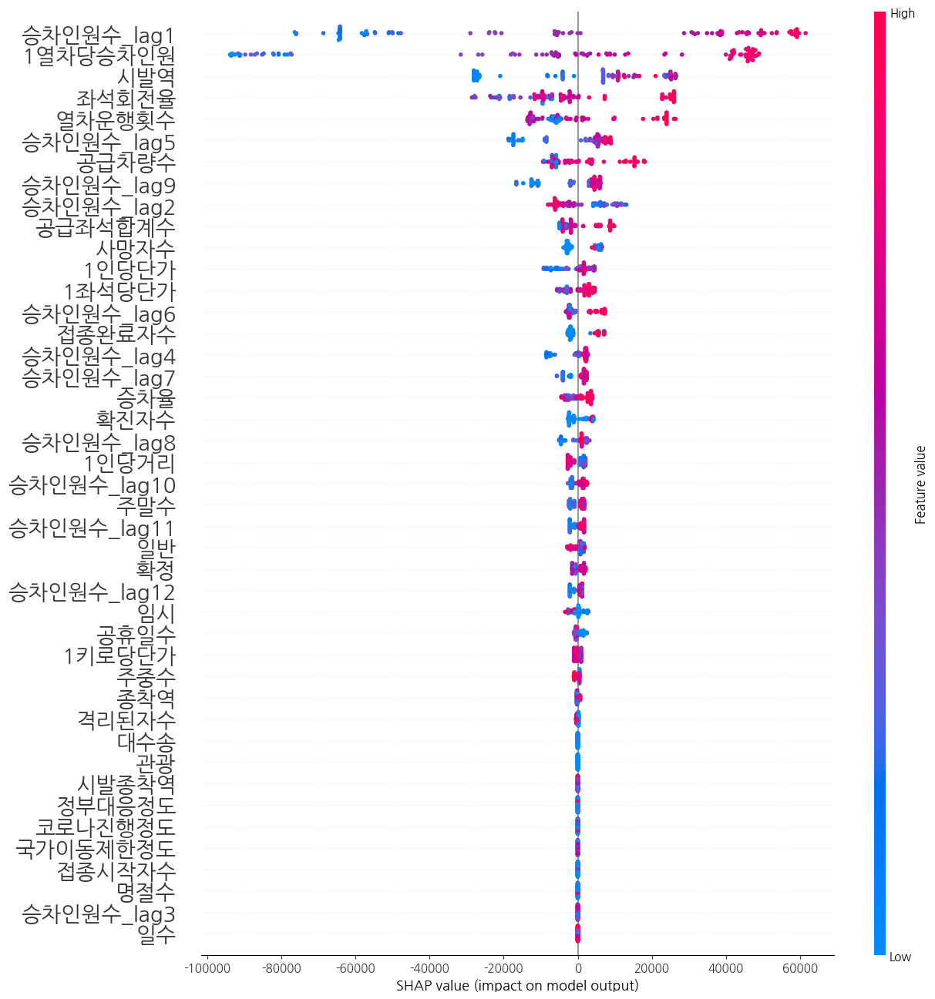

2

Explanations for a Random Test Sample:


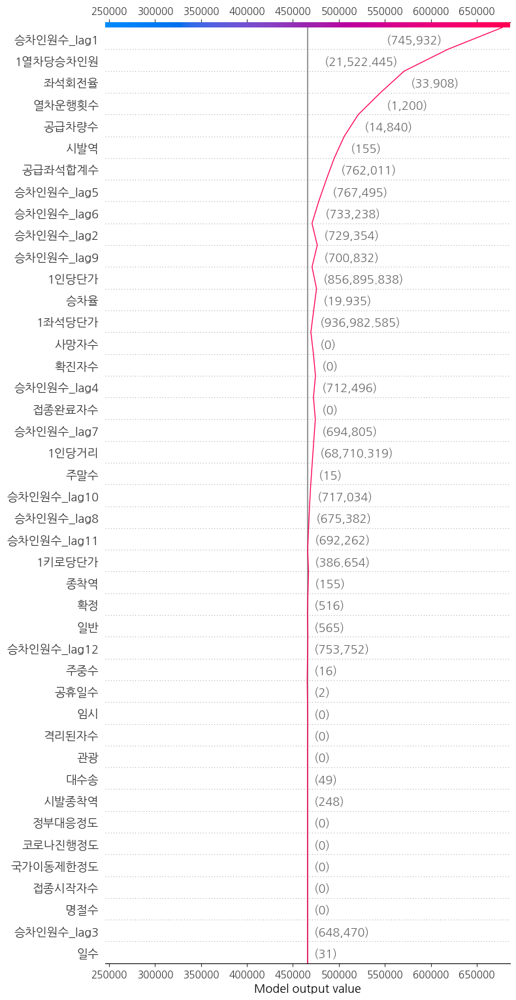

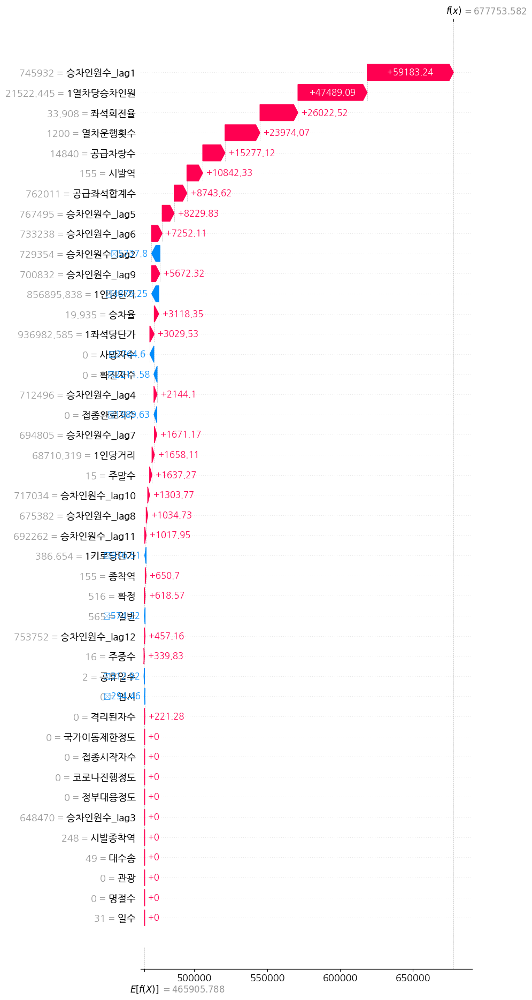

Performance: 


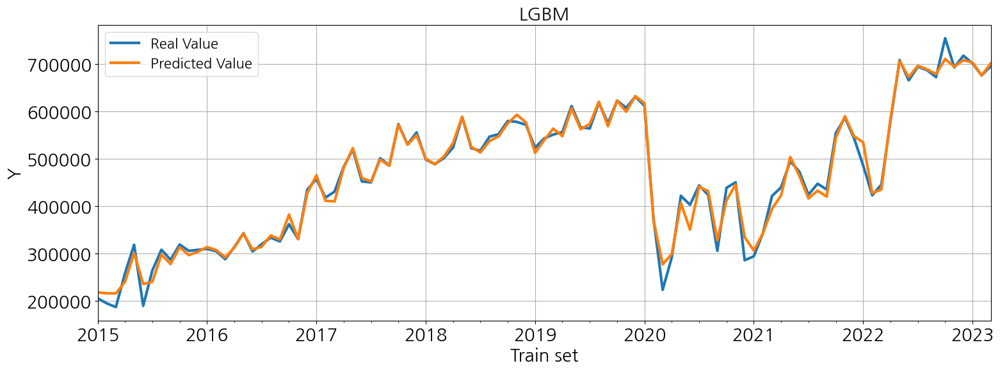

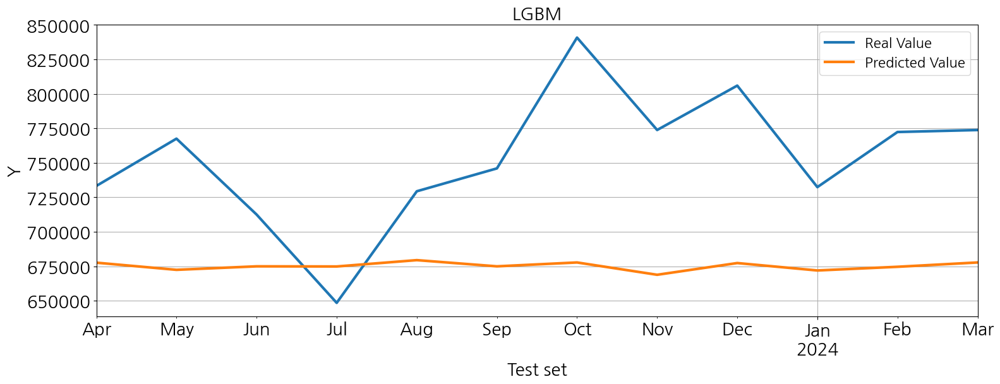

전체 호남선


Explanations for Train Dataset:


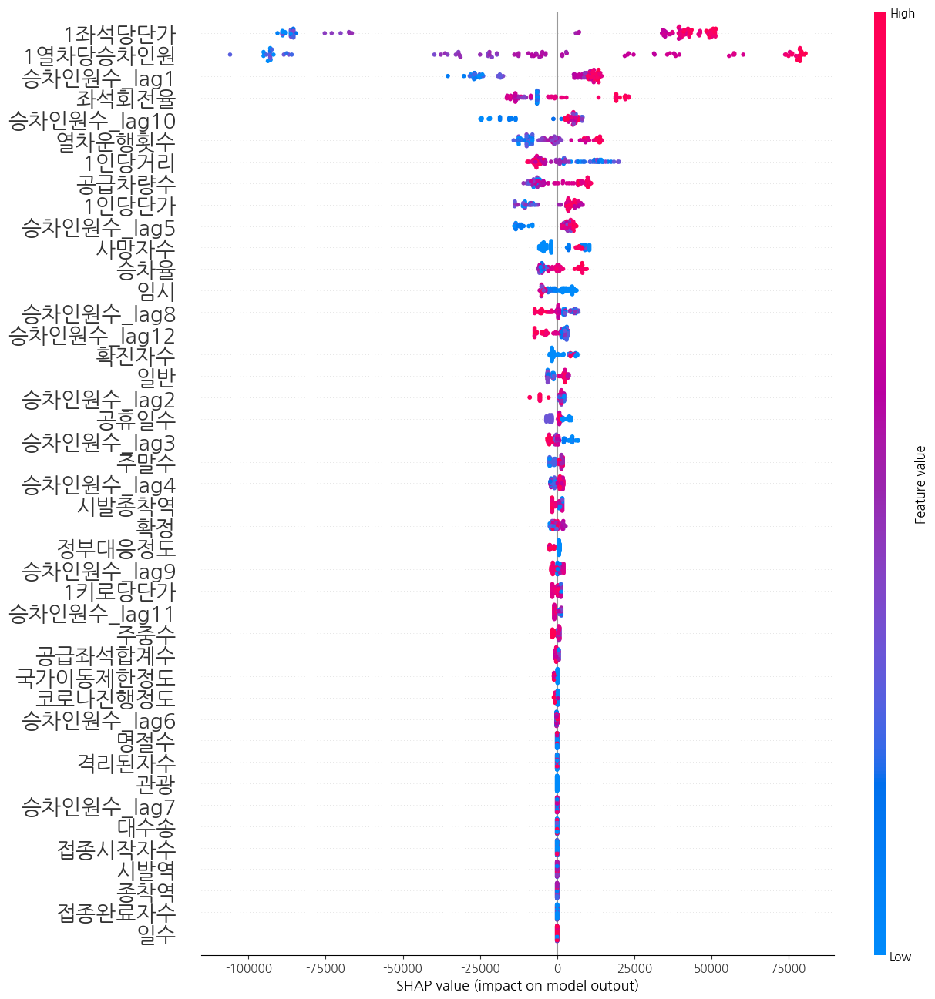

2

Explanations for a Random Test Sample:


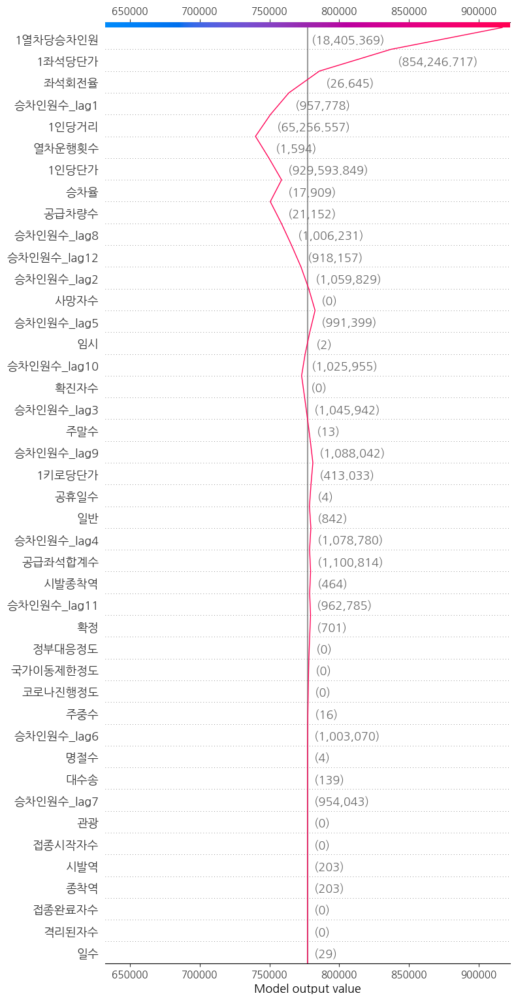

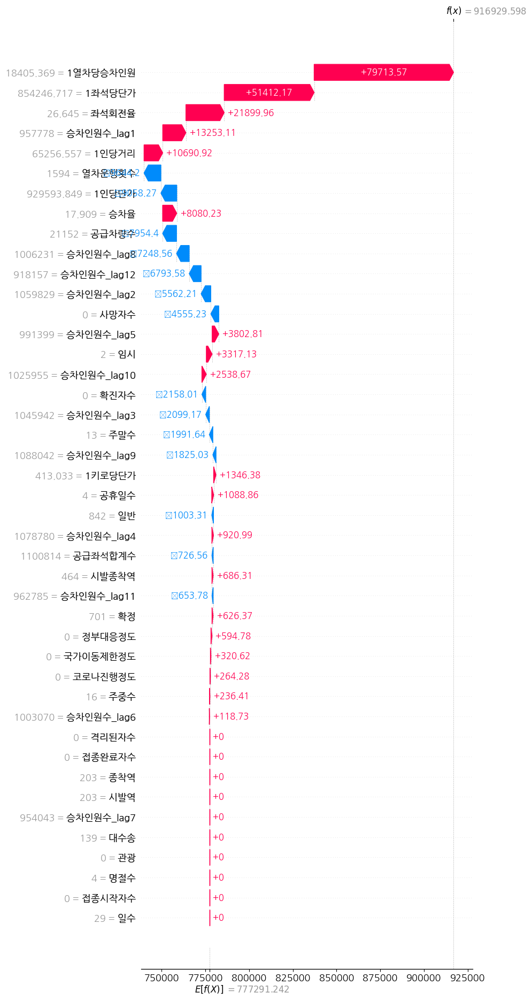

Performance: 


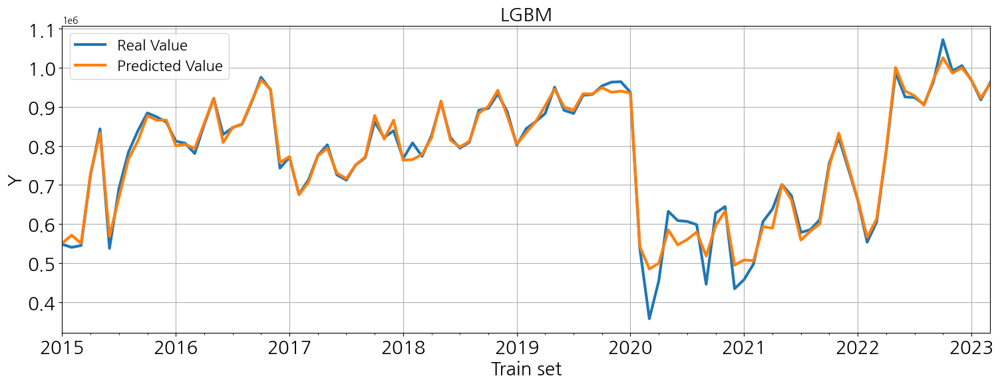

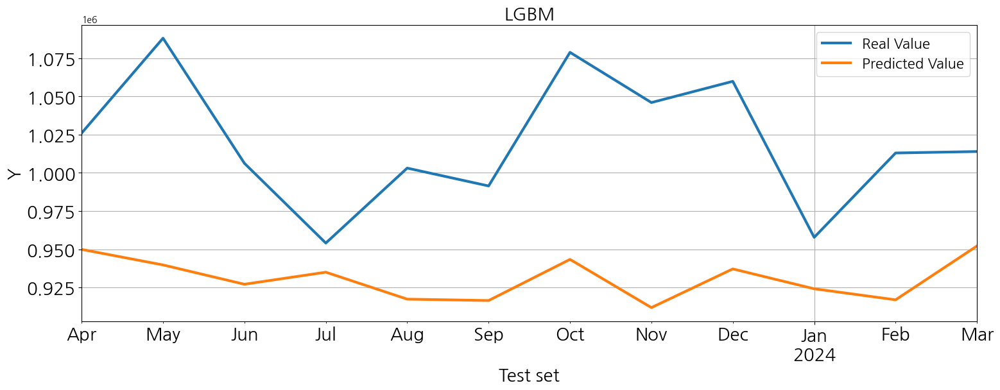

In [28]:
## 모델링변수설정
LAG_LENGTH = None
X_col_FUTR = ['일수', '주말수', '주중수', '공휴일수', '명절수',
              '공급좌석합계수', '승차율', '열차운행횟수']
X_col_HISTR = 'auto'
X_col_STATIC_ML = []
X_col_STATIC_DL = None

# 대상선정
for target_line in lines:
    # 저장오픈
    if LAG_LENGTH == None:
        save_name_feature = 'FUTR'+str(len(X_col_FUTR))+'+'+'LAG0'
    else:
        save_name_feature = 'FUTR'+str(len(X_col_FUTR))+'+'+'LAG'+str(LAG_LENGTH)
    save_name = 'Forecasting_'+target_line+'_'+save_name_feature+'.xlsx'
    with pd.ExcelWriter(os.path.join(os.getcwd(), 'Result', save_name), engine='xlsxwriter') as writer:
        for target_dow in dows:
            print(target_dow, target_line)
            
            # 데이터로딩 및 전처리
            df_sub = df[(df['전체주중주말'] == target_dow) & (df['주운행선'] == target_line)].iloc[:,2:]
            ## Lagging
            df_sub,_ = feature_lagging(df_sub, Y_colname, direction='downward', lag_length=12)
            ## 날짜처리
            df_sub['운행년월'] = pd.to_datetime(df_sub['운행년월'])
            df_sub = df_sub.set_index('운행년월')
            df_sub = df_sub[df_sub.index <= DATE_SPLITS[1]]
            ## 데이터분리
            df_train, df_validate = df_sub[df_sub.index <= DATE_SPLITS[0]], df_sub[df_sub.index > DATE_SPLITS[0]]
            Y_train, X_train = df_train[[Y_colname]], df_train[[i for i in df_train.columns if i != Y_colname]]
            Y_validate, X_validate = df_validate[[Y_colname]], df_validate[[i for i in df_validate.columns if i != Y_colname]]

            # 모델링
            modeling_LGBMRegressor(X_train.values, Y_train, X_validate.values, Y_validate, 
                                   list(X_train.columns), shap=True, X_top_display=50)     

# Revision

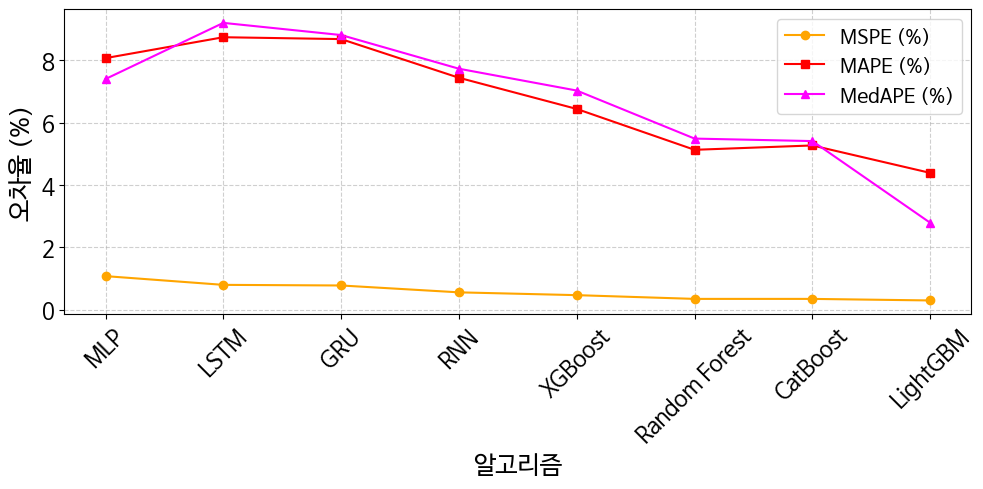

In [10]:
import pandas as pd
import matplotlib.pyplot as plt

# 데이터 정의
data = {
    "Algorithm": ["LightGBM", "Random Forest", "CatBoost", "XGBoost", "RNN", "MLP", "GRU", "LSTM"],
    "MSPE": [0.3, 0.35, 0.35, 0.47, 0.56, 1.08, 0.78, 0.8],
    "MAPE": [4.39, 5.13, 5.27, 6.44, 7.44, 8.07, 8.68, 8.74],
    "MedAPE": [2.79, 5.49, 5.41, 7.03, 7.73, 7.4, 8.81, 9.2]
}

df = pd.DataFrame(data)

# MSPE 기준으로 내림차순 정렬
df_sorted = df.sort_values(by="MSPE", ascending=False)

# 선그래프 시각화
plt.figure(figsize=(10, 5))
plt.plot(df_sorted["Algorithm"], df_sorted["MSPE"], marker='o', label="MSPE (%)", color='orange')
plt.plot(df_sorted["Algorithm"], df_sorted["MAPE"], marker='s', label="MAPE (%)", color='red')
plt.plot(df_sorted["Algorithm"], df_sorted["MedAPE"], marker='^', label="MedAPE (%)", color='magenta')

# plt.title("알고리즘별 예측 오차율 비교 (MSPE 기준 내림차순)", fontsize=16, fontweight='bold')
plt.xlabel("알고리즘", fontsize=18, fontweight='bold')
plt.ylabel("오차율 (%)", fontsize=18, fontweight='bold')
plt.xticks(rotation=45, fontsize=16, fontweight='bold')
plt.yticks(fontsize=16, fontweight='bold')
plt.legend(fontsize=14)
plt.grid(True, linestyle='--', alpha=0.6)

plt.tight_layout()
plt.show()


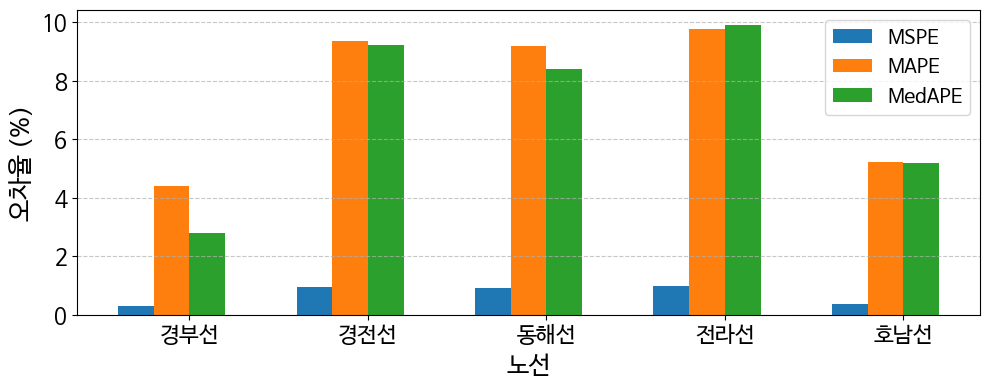

In [9]:
import pandas as pd
import matplotlib.pyplot as plt

data = {
"노선": ["경부선", "경전선", "동해선", "전라선", "호남선"],
"알고리즘": ["LightGBM", "LightGBM", "XGBoost", "LSTM", "XGBoost"],
"MSPE(%)": [0.30, 0.94, 0.91, 0.99, 0.37],
"MAPE(%)": [4.39, 9.35, 9.18, 9.77, 5.22],
"MedAPE(%)": [2.79, 9.22, 8.40, 9.92, 5.17],
}

df = pd.DataFrame(data)

# 그래프 생성
plt.figure(figsize=(10, 4))
bar_width = 0.2
index = range(len(df))

plt.bar(index, df["MSPE(%)"], bar_width, label="MSPE")
plt.bar([i + bar_width for i in index], df["MAPE(%)"], bar_width, label="MAPE")
plt.bar([i + bar_width*2 for i in index], df["MedAPE(%)"], bar_width, label="MedAPE")

# X, Y축 레이블 및 폰트 크기/스타일 조정
plt.xlabel("노선", fontsize=18)
plt.ylabel("오차율 (%)", fontsize=18)
# plt.title("KTX 노선별 예측 성능 비교", fontsize=16, fontweight='bold')

# X축 및 Y축 tick 폰트 크기 및 스타일 조정
plt.xticks([i + bar_width*1.5 for i in index], df["노선"], fontsize=16)
plt.yticks(fontsize=16)

# 범례 및 레이아웃 설정
plt.legend(fontsize=14)
plt.tight_layout()

# Y축 그리드 추가
plt.grid(axis='y', linestyle='--', alpha=0.7)

# 그래프 표시
plt.show()


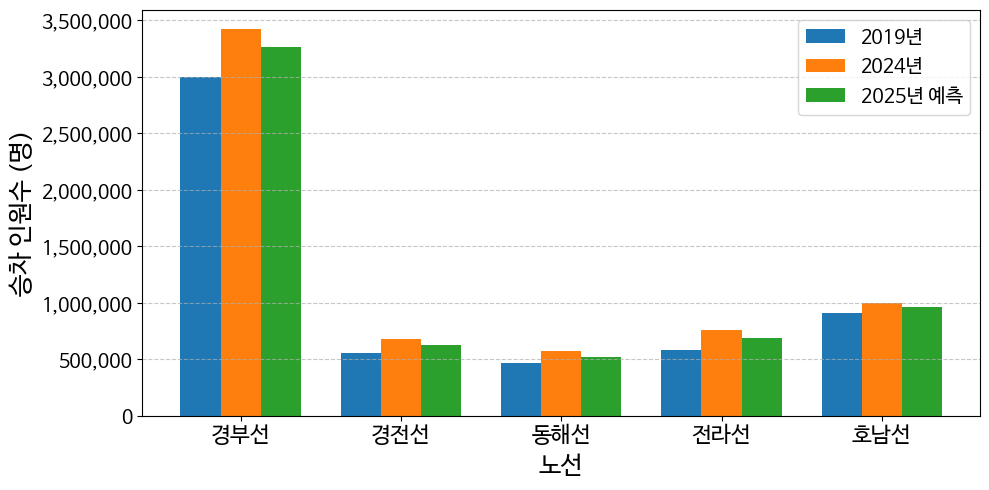

In [6]:
import matplotlib.pyplot as plt
from matplotlib.ticker import StrMethodFormatter

labels = ["경부선", "경전선", "동해선", '전라선', '호남선']
year_2019 = [3000064, 552302, 470230, 580489, 905066]
year_2024 = [3418760, 675125, 573080, 759476, 994880]
year_2025 = [3261319, 624792, 521400, 687733, 964904]

x = range(len(labels))
bar_width = 0.25

# 막대그래프 그리기
plt.figure(figsize=(10, 5))
plt.bar(x, year_2019, width=bar_width, label='2019년')
plt.bar([i + bar_width for i in x], year_2024, width=bar_width, label='2024년')
plt.bar([i + bar_width * 2 for i in x], year_2025, width=bar_width, label='2025년 예측')

plt.xlabel("노선", fontsize=18)
plt.ylabel("승차 인원수 (명)", fontsize=18)
plt.xticks([i + bar_width for i in x], labels, fontsize=16)
plt.yticks(fontsize=14)

# y축 숫자에 콤마 추가
plt.gca().yaxis.set_major_formatter(StrMethodFormatter('{x:,.0f}'))

plt.legend(fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()
